# Utilities and imports

In [1]:
from maxentnuc.analysis.domain_analyzer import DomainAnalyzer, get_boundary_loops, Domains
from maxentnuc.analysis.mei_analyzer import MEIAnalyzer
from maxentnuc.analysis.analysis import *
from maxentnuc.analysis.insulation import *

from scipy.ndimage import gaussian_filter1d
from matplotlib.colors import LogNorm
import os
from cooltools.api.insulation import _insul_diamond_dense
from neighbor_balance.plotting import parse_region, format_ticks, ContactMap, apply_matplotlib_style, load_bw, bin_track, stylize_gene_name

def plot_gallery_list(domains, func=lambda x, ax: x.plot_chain_2D(ax=ax, colorbar=False, s=1), size=500, rows=3, scalebar=500, fname=None):
    assert not len(domains) % rows
    cols = len(domains) // rows
    assert cols < 10

    aspect = 0.6
    size_h = size * aspect
    f, ax = plt.subplots(rows, cols, sharex=True, sharey=True, figsize=(3*cols, 3*rows*aspect),
                         gridspec_kw=dict(hspace=0, wspace=0))

    axs = ax.flatten()
    
    for ax, domain in zip(axs, domains):
        func(domain, ax)
        ax.set_xlabel(None)
        ax.set_ylabel(None)
        ax.set_xlim(-size, size)
        ax.set_ylim(-size_h, size_h)
        ax.axis('off')

    axs[-1].plot([-scalebar/2, scalebar/2], [size_h/20-size_h, size_h/20-size_h], c='k', solid_capstyle="butt", lw=2)
    axs[-1].text(0, size_h/40-size_h, f'{scalebar} nm', va='top', ha='center')
    return f, ax

omics = '/home/joepaggi/orcd/pool/omics'
mei_runs = '/orcd/data/binz/001/joepaggi/mei_runs'

apply_matplotlib_style()

In [2]:
main_names = ['nanog', 'sox2', 'fbn2', 'klf1', 'ppm1g']

stylized_names = {name: stylize_gene_name(name) for name in main_names}
stylized_names['ppm1g_rad21_aid'] = stylize_gene_name('ppm1g') + ' RAD21 AID'
stylized_names['ppm1g_ice'] = stylize_gene_name('ppm1g') + ' ICE'
stylized_names['packing domains'] = 'Packing domains'
stylized_names

{'nanog': '$\\mathit{Nanog}$',
 'sox2': '$\\mathit{Sox2}$',
 'fbn2': '$\\mathit{Fbn2}$',
 'klf1': '$\\mathit{Klf1}$',
 'ppm1g': '$\\mathit{Ppm1g}$',
 'ppm1g_rad21_aid': '$\\mathit{Ppm1g}$ RAD21 AID',
 'ppm1g_ice': '$\\mathit{Ppm1g}$ ICE',
 'packing domains': 'Packing domains'}

In [3]:
import pickle

def compute_domains(prod):
    analyzer = DomainAnalyzer(30, 200, min_loop_size=2, add_boundary_linkers=True)
    print(analyzer.min_samples, to_micromolar(analyzer.min_samples, 4/3*np.pi*30**3))

    domains = {}
    for name, info in prod.items():
        trajectory = info['mei'].get_positions(info['iteration'], skip=11, burnin=0)
        trajectory = trajectory.reshape(-1, *trajectory.shape[-2:])
        domains[name] = analyzer.analyze_trajectory(trajectory)
    return domains

def load_or_compute_domains(prod, cache_file):
    if os.path.exists(cache_file):
        print("Loading cached domains...")
        with open(cache_file, 'rb') as f:
            data = pickle.load(f)
            domains = data['domains']
            _prod = data['prod']

            for k in prod:
                assert prod[k]['config'] == _prod[k]['config']
                assert prod[k]['iteration'] == _prod[k]['iteration']
    else:
        print("Computing domains...")
        domains = compute_domains(prod)
        with open(cache_file, 'wb') as f:
            data = {
                'domains': domains,
                'prod': prod,
            }
            pickle.dump(data, f)
    return domains

prod = {
    'nanog': {'config': f'{mei_runs}/nanog/v36/config.yaml', 'iteration': 18},
    'klf1': {'config': f'{mei_runs}/klf1/v3/config.yaml', 'iteration': 11},
    'ppm1g': {'config': f'{mei_runs}/ppm1g/v2/config.yaml', 'iteration': 10},
    'ppm1g_ice': {'config': f'{mei_runs}/ppm1g/v3/config.yaml', 'iteration': 12},
    'ppm1g_rad21_aid': {'config': f'{mei_runs}/ppm1g/v4/config.yaml', 'iteration': 24},
    'sox2': {'config': f'{mei_runs}/sox2/v11/config.yaml', 'iteration': 13},
    'fbn2' : {'config': f'{mei_runs}/fbn2/v2/config.yaml', 'iteration': 12},
}

for name in prod:
    prod[name]['mei'] = MEIAnalyzer(prod[name]['config'], scale=0.1)

cache_file = 'data/domains.pkl'
domains = load_or_compute_domains(prod, cache_file)

Loading cached domains...


# Insulation scores

In [4]:
for name, info in prod.items():
    root = os.path.dirname(info['config'])
    config = os.path.basename(info['config'])
    cmd = f'python -m na_genes.analysis.insulation --iteration {info["iteration"]} --skip 11 --config {config}'
    print(f'cd {root}; sbatch -J {name} --wrap="{cmd}"')

cd /orcd/data/binz/001/joepaggi/mei_runs/nanog/v36; sbatch -J nanog --wrap="python -m na_genes.analysis.insulation --iteration 18 --skip 11 --config config.yaml"
cd /orcd/data/binz/001/joepaggi/mei_runs/klf1/v3; sbatch -J klf1 --wrap="python -m na_genes.analysis.insulation --iteration 11 --skip 11 --config config.yaml"
cd /orcd/data/binz/001/joepaggi/mei_runs/ppm1g/v2; sbatch -J ppm1g --wrap="python -m na_genes.analysis.insulation --iteration 10 --skip 11 --config config.yaml"
cd /orcd/data/binz/001/joepaggi/mei_runs/ppm1g/v3; sbatch -J ppm1g_ice --wrap="python -m na_genes.analysis.insulation --iteration 12 --skip 11 --config config.yaml"
cd /orcd/data/binz/001/joepaggi/mei_runs/ppm1g/v4; sbatch -J ppm1g_rad21_aid --wrap="python -m na_genes.analysis.insulation --iteration 24 --skip 11 --config config.yaml"
cd /orcd/data/binz/001/joepaggi/mei_runs/sox2/v11; sbatch -J sox2 --wrap="python -m na_genes.analysis.insulation --iteration 13 --skip 11 --config config.yaml"
cd /orcd/data/binz/001

In [5]:
insulations = {}
for name in prod:
    fname = os.path.dirname(prod[name]['config']) + '/insulation.pkl'
    print(fname)
    with open(fname, 'rb') as f:
        ins = pickle.load(f)
        print(ins['params'])
        insulations[name] = ins['scores']

/orcd/data/binz/001/joepaggi/mei_runs/nanog/v36/insulation.pkl


{'radius': 40, 'ignore_diags': 2}
/orcd/data/binz/001/joepaggi/mei_runs/klf1/v3/insulation.pkl
{'radius': 40, 'ignore_diags': 2}
/orcd/data/binz/001/joepaggi/mei_runs/ppm1g/v2/insulation.pkl
{'radius': 40, 'ignore_diags': 2}
/orcd/data/binz/001/joepaggi/mei_runs/ppm1g/v3/insulation.pkl
{'radius': 40, 'ignore_diags': 2}
/orcd/data/binz/001/joepaggi/mei_runs/ppm1g/v4/insulation.pkl
{'radius': 40, 'ignore_diags': 2}
/orcd/data/binz/001/joepaggi/mei_runs/sox2/v11/insulation.pkl
{'radius': 40, 'ignore_diags': 2}
/orcd/data/binz/001/joepaggi/mei_runs/fbn2/v2/insulation.pkl
{'radius': 40, 'ignore_diags': 2}


In [6]:
windows = [5, 10, 50, 500]

median_insulation = {}
for w in windows:
    all_ins = []
    for name in ['fbn2', 'ppm1g', 'klf1']:
        insulation = insulations[name]
        ins = insulation[w].flatten()
        all_ins += [ins]
    median_insulation[w] = np.median(np.concatenate(all_ins))
median_insulation

{5: np.float64(-0.4594316186372972),
 10: np.float64(-1.4706298252421612),
 50: np.float64(-4.4658011435130245),
 500: np.float64(-7.794560144799579)}

In [7]:
domains_ins = {}
for name, _domains in domains.items():
    print(name)
    insulation = insulations[name]
    mask = insulation[10] > median_insulation[10] - 1.0
    assert len(_domains) == len(mask), f'Number of domains ({len(_domains)}) does not match number of insulation masks ({len(mask)}) for {name}'

    domains_ins[name] = []
    for i in range(len(_domains)):
        positions = _domains[i].positions.copy()
        labels = get_segments(mask[i])
        domains_ins[name] += [Domains(positions, labels)]

nanog


klf1
ppm1g
ppm1g_ice
ppm1g_rad21_aid
sox2
fbn2


# Compare insulation scores with different values of ignore diags.

In [10]:
trajectory = np.array([domain.positions for domain in domains[name]])[::1000]
print(trajectory.shape)
all_ins_ignore_diags4 = get_insulation_scores(trajectory, [5, 10, 30], ignore_diags=4)
all_ins_ignore_diags2 = get_insulation_scores(trajectory, [5, 10, 30], ignore_diags=2)

(2, 4910, 3)


/orcd/home/002/joepaggi/maxentnuc/maxentnuc/analysis/insulation.py:23: RuntimeWarning: divide by zero encountered in log2
  scores = np.log2(_insul_diamond_dense(contact_map, window=window, norm_by_median=False,
/orcd/home/002/joepaggi/maxentnuc/maxentnuc/analysis/insulation.py:23: RuntimeWarning: divide by zero encountered in log2
  scores = np.log2(_insul_diamond_dense(contact_map, window=window, norm_by_median=False,
/orcd/home/002/joepaggi/maxentnuc/maxentnuc/analysis/insulation.py:23: RuntimeWarning: divide by zero encountered in log2
  scores = np.log2(_insul_diamond_dense(contact_map, window=window, norm_by_median=False,
/orcd/home/002/joepaggi/maxentnuc/maxentnuc/analysis/insulation.py:23: RuntimeWarning: divide by zero encountered in log2
  scores = np.log2(_insul_diamond_dense(contact_map, window=window, norm_by_median=False,
/orcd/home/002/joepaggi/maxentnuc/maxentnuc/analysis/insulation.py:23: RuntimeWarning: divide by zero encountered in log2
  scores = np.log2(_insul_diam

(2, 4310)
69
0
0.14327146171693736
(2, 4310)
28
0
0.19895591647331787


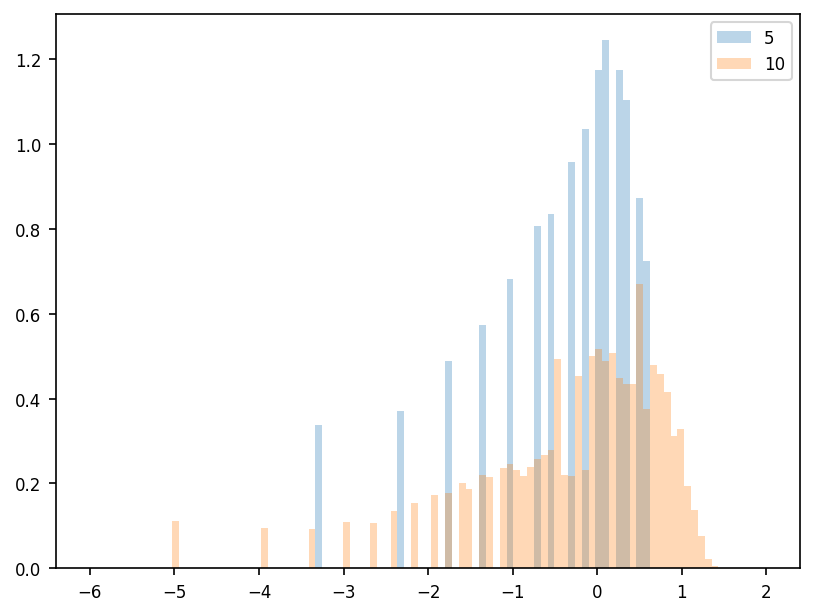

In [11]:
bins = np.linspace(-6, 2, 100)
for window in windows:
    if window > 30:
        continue
    ins = all_ins_ignore_diags4[window][:, 300:-300].copy()
    print(ins.shape)
    print(np.sum(np.isinf(ins)))
    ins[np.isinf(ins)] = np.min(ins[~np.isinf(ins)])
    print(np.sum(np.isinf(ins)))
    print(np.mean(ins < np.median(ins) - 1))
    plt.hist(ins.flatten() - np.median(ins), label=window, alpha=0.3, density=True, bins=bins)
plt.legend()
plt.show()

(2, 4310)
0
0
0.04605568445475638
(2, 4310)
0
0
0.13665893271461718


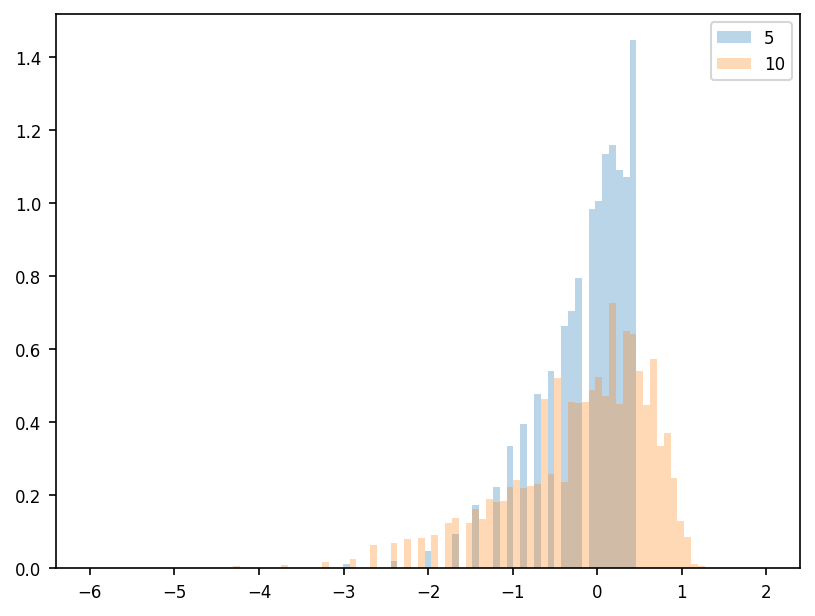

In [12]:
bins = np.linspace(-6, 2, 100)
for window in windows:
    if window > 30:
        continue
    ins = all_ins_ignore_diags2[window][:, 300:-300].copy()
    print(ins.shape)
    print(np.sum(np.isinf(ins)))
    ins[np.isinf(ins)] = np.min(ins[~np.isinf(ins)])
    print(np.sum(np.isinf(ins)))
    print(np.mean(ins < np.median(ins) - 1))
    plt.hist(ins.flatten() - np.median(ins), label=window, alpha=0.3, density=True, bins=bins)
plt.legend()
plt.show()

# PPM1G zooms

In [13]:
name = 'ppm1g'

region = prod['ppm1g']['mei'].mei.config['region']
chrom, start, end = parse_region(region)
ref_map = prod['ppm1g']['mei'].get_reference_contact_map()

atac = f'{omics}/genomics_data/GSE98390_E14_ATAC_MERGED.DANPOS.mm39.bw'
atac = load_bw(atac, chrom, start, end)
atac = bin_track(atac, step=200)

In [14]:
# zoom = (250, 750)  # Microdomains
# zoom = (2250, 2750) # Another microdomains
# zoom = (2900, 3400) # Largely featureless
# zoom = (3500, 4000)  # Region with insulation but no ATAC

zoom_names = ['microdomains100k', 'featureless100k']#, 'microdomains50k']
zooms = [(250, 750), (2900, 3400)] #, (410, 660), ]

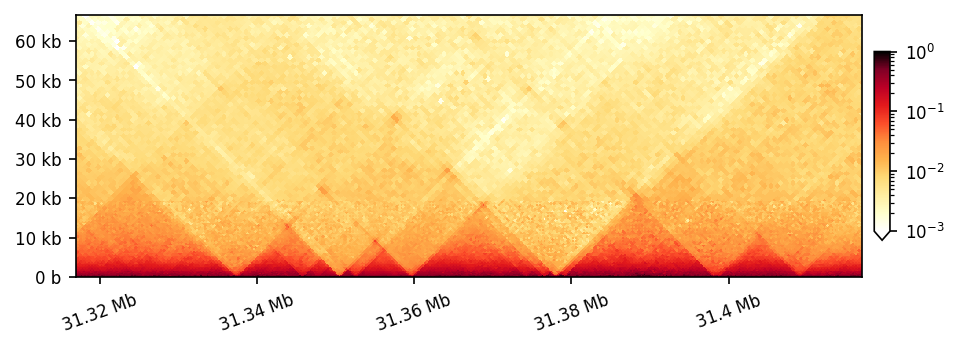

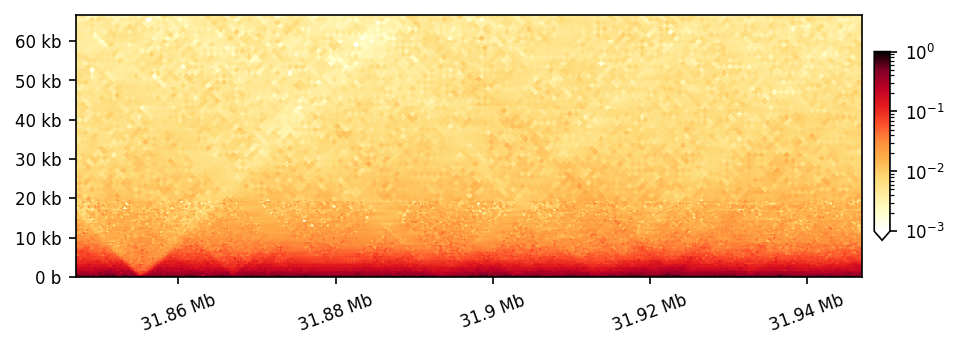

In [15]:
vmin = 1e-3
w = 10

ref_insulation_scores = np.log2(_insul_diamond_dense(ref_map, window=w, norm_by_median=False))
boundaries = get_boundaries(mask_insulation_scores(ref_insulation_scores[None, :]), threshold=1.0)

for zoom_name, zoom in zip(zoom_names, zooms):
    f, ax = plt.subplots(1, 2, figsize=(7, 2.45), sharex='col', constrained_layout=False,
                         gridspec_kw={'height_ratios':[8], 'width_ratios': [1, 0.02], 'wspace': 0.03, 'hspace': 0.05})
    x = np.arange(start, end, 200)

    # Show the contact map.
    contact_map = ContactMap(ref_map, chrom, start, end, resolution=200)
    im = contact_map.plot_contact_map_horizontal(ax=ax[0], depth=2/3*200*(zoom[1] - zoom[0]), vmin=vmin, colorbar=False)
    plt.colorbar(im, cax=ax[1], extend='min')
    pos = ax[1].get_position()
    shrink = 2/3
    ax[1].set_position([pos.x0, pos.y0 + pos.height * (1 - shrink) / 2, pos.width, pos.height*shrink])
    i = 1

    # Insulation scores
    # ax[i, 0].set_ylabel('Insulation', rotation=0, ha='right', va='center')
    # ax[i, 0].plot(np.arange(start, end, 200), ref_insulation_scores, c='k')
    # for b in boundaries[0]:
    #     ax[i, 0].axvline(b*200+start, c='gray')
    # ax[i, 1].axis('off')
    # i += 1
    
    ax[0].set_xlim(start+zoom[0]*200, start+zoom[1]*200)
    format_ticks(ax[0])

    plt.savefig(f'img/microdomains_refmap_{zoom_name}.pdf')
    plt.show()

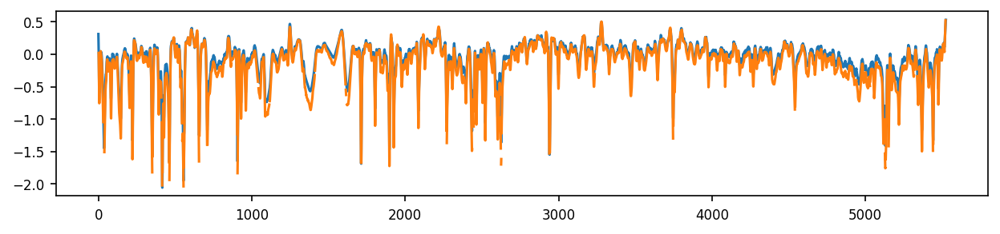

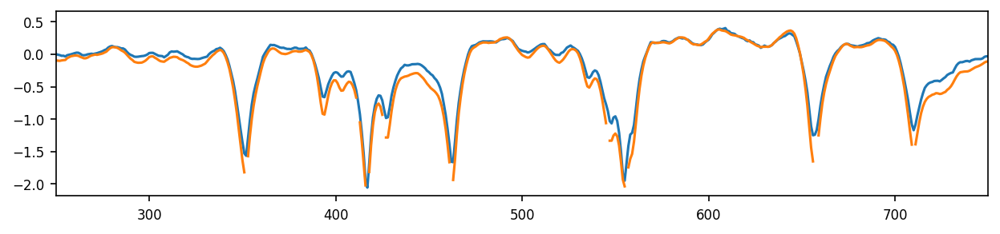

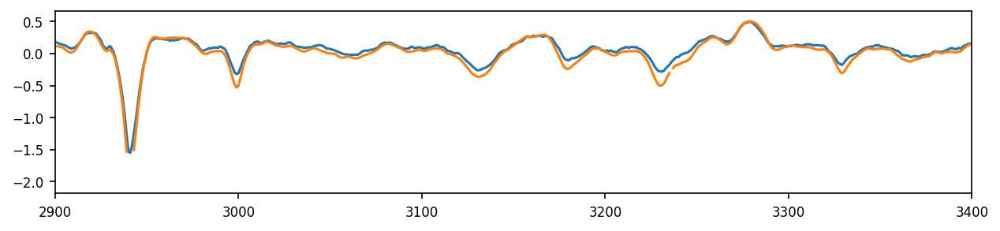

In [16]:
# Compare the reference insulation scores with the insulation scores of the simulated data.

f, ax = plt.subplots(figsize=(10, 2))
plt.plot(ref_insulation_scores - np.median(ref_insulation_scores))
plt.plot(np.mean(insulations[name][w] - np.median(insulations[name][w]), axis=0))
plt.show()

for zoom in zooms:
    f, ax = plt.subplots(figsize=(10, 2))
    plt.plot(ref_insulation_scores - np.median(ref_insulation_scores))
    plt.plot(np.mean(insulations[name][w] - np.median(insulations[name][w]), axis=0))
    plt.xlim(*zoom)
    plt.show()

################################################################################
(250, 750)
(1600, 5525)
isinf 82
insulation < -2.4706298252421615


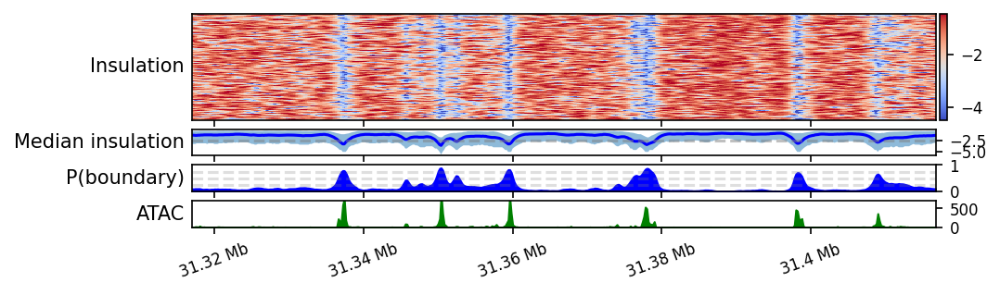

################################################################################
(2900, 3400)
(1600, 5525)
isinf 82
insulation < -2.4706298252421615


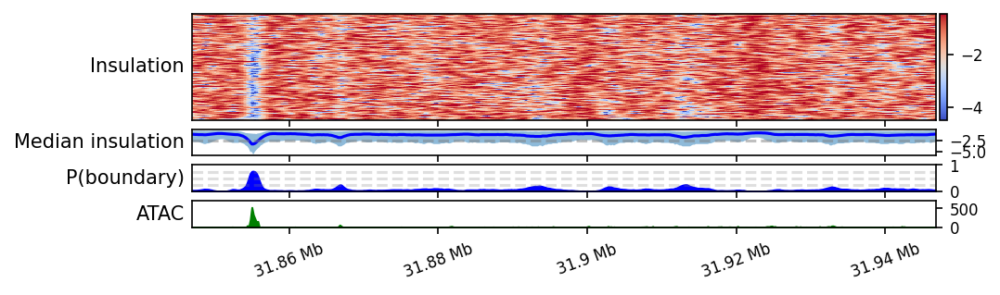

In [17]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import linkage, dendrogram, leaves_list


def plot_clustering(data_to_cluster, data_to_show=None, cmap='viridis', ax=None, **kwargs):
    if data_to_show is None:
        data_to_show = data_to_cluster

    Z = linkage(data_to_cluster, method='ward', optimal_ordering=True)
    leaf_order = leaves_list(Z)
    sorted_data = data_to_show[leaf_order]

    #dendrogram(Z, ax=ax[0], orientation='left', no_labels=True)
    im = ax[0].imshow(sorted_data, aspect='auto', cmap=cmap, interpolation='none', **kwargs)
    plt.colorbar(im, cax=ax[1])
    ax[0].set_yticks([])

def plot_insulation(x, data, atac, ci=2.5, width=2, threshold=0.5, v=2, atac_ymax=700):
    fig, ax = plt.subplots(4, 2, figsize=(7, 2), sharex='col',
                           gridspec_kw={'width_ratios':[10, 0.1], 'height_ratios':[4, 1, 1, 1], 'wspace': 0.01})

    plot_clustering(data, data_to_show=data, ax=ax[0], cmap='coolwarm',
                    vmin=threshold-v, vmax=threshold+v,
                    extent=(x[0], x[-1], 1, 0))
    ax[0, 0].set_ylabel('Insulation', rotation=0, ha='right', va='center')
    
    med = np.percentile(data, 50, axis=0)
    low, high = np.percentile(data, ci, axis=0), np.percentile(data, 100-ci, axis=0)
    ax[1, 0].fill_between(x, low, high, alpha=0.5)
    ax[1, 0].plot(x, med, c='blue')
    ax[1, 0].axhline(threshold, c='gray', ls='--', alpha=0.5)
    ax[1, 1].axis('off')
    ax[1, 0].set_ylabel('Median insulation', rotation=0, ha='right', va='center')
    ax[1, 0].yaxis.tick_right()

    mask = data < threshold
    p = mask.mean(axis=0)
    #p_sum = np.array([np.mean(np.any(mask[:, max(0, i-width):min(len(p),i+width+1)], axis=1)) for i in range(mask.shape[1])])

    ax[2, 0].fill_between(x, 0, p, color='blue')
    #ax[2, 1].plot(x, p_sum, c='blue')
    for h in [0.25, 0.5, 0.75]:
        ax[2, 0].axhline(h, ls='--', c='gray', alpha=0.25)
    ax[2, 1].axis('off')
    ax[2, 0].set_ylim(0, 1)
    ax[2, 0].set_ylabel('P(boundary)', rotation=0, ha='right', va='center')
    ax[2, 0].yaxis.tick_right()

    ax[3, 0].fill_between(x, 0, atac, color='green')
    ax[3, 0].set_ylabel('ATAC', rotation=0, ha='right', va='center')
    ax[3, 1].axis('off')
    ax[3, 0].yaxis.tick_right()
    ax[3, 0].set_ylim(0, atac_ymax)
    format_ticks(ax[3, 0], y=False)
    return fig, ax

for zoom_name, zoom in zip(zoom_names, zooms):
    print('#'*80)
    print(zoom)
    
    w = 10
    cut = 1.0
    ins = insulations[name][w].copy()

    print(ins.shape)
    print('isinf', np.sum(np.isinf(ins)))
    ins[np.isinf(ins)] = np.min(ins[~np.isinf(ins)])
    insulation_thresh = median_insulation[w] - cut
    print(f'insulation < {insulation_thresh}')

    x = np.arange(start+200*zoom[0], start+200*zoom[1], 200)
    plot_insulation(x, ins[:, zoom[0]:zoom[1]], atac[zoom[0]:zoom[1]], threshold=insulation_thresh)
    plt.savefig(f'img/microdomains_insulation_{zoom_name}.pdf')
    plt.show()

-3.5921999622824643
-3.4749088650740996
-3.7103416506232927
-4.201363996029861
-3.8024883768346203
-4.094674552837511
-3.3951186330980208
-3.3170806728575237
-3.7971030931939094
-3.8320694112704996
-3.6158317044313226
-3.2815216971223378
-3.021565935663244
-3.197017790794537
-3.33137324020099
-3.207367735856553
-3.5101567073525497
-3.6935209058317526
-3.13713431667726
-3.5510789865846615
-3.318665712307057
-3.4724358583122026
################################################################################
(250, 750)


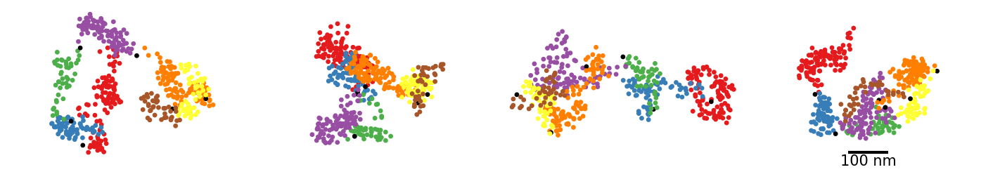

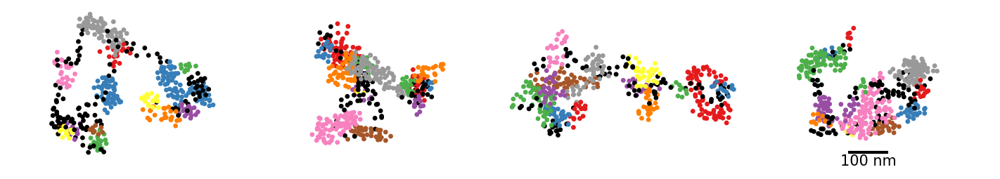

################################################################################
(2900, 3400)


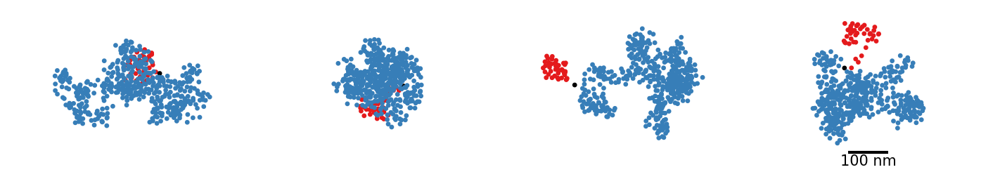

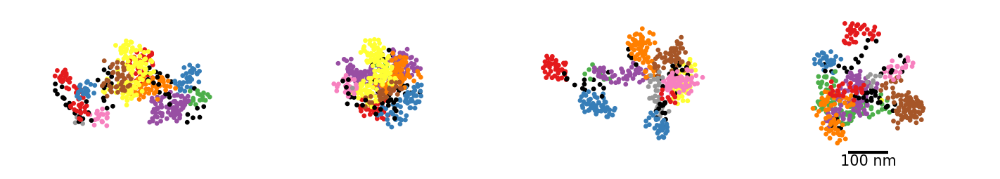

In [18]:
# Make scatter plot style renderings.

def get_domain_ins(positions, window=50, threshold=1, use_peaks=True):
    insulation_scores = get_insulation_scores(positions[None, :], windows=[window])[window]
    if use_peaks:
        masked = mask_insulation_scores(insulation_scores)
        boundaries = get_boundaries(masked, threshold=threshold)
        sections = get_sections(len(positions), boundaries)[0]
        return Domains(positions, sections.astype(int))
    else:
        mask = insulation_scores[0] > threshold
        sections = get_segments(mask)
        return Domains(positions, sections.astype(int))

w = 10
examples = 4
ref_threshold = 1.0
abs_frame_threshold = median_insulation[w] - 1

ref_insulation_scores = np.log2(_insul_diamond_dense(ref_map, window=w, norm_by_median=False))
boundaries = get_boundaries(mask_insulation_scores(ref_insulation_scores[None, :]), threshold=ref_threshold)
sections = get_sections(len(ref_insulation_scores), boundaries)[0]
for b in boundaries[0]:
    sections[b] = -1
    print(ref_insulation_scores[b])

dbscan = domains[name][::len(domains[name])//examples][:examples]
refs = []
frames = []
frames1 = []
frames2 = []
for domain in dbscan:
    refs += [Domains(domain.positions, sections.astype(int))]
    frames += [get_domain_ins(domain.positions, window=w, threshold=abs_frame_threshold, use_peaks=False)]


for zoom_name, zoom in zip(zoom_names, zooms):
    print('#'*80)
    print(zoom)
    zoomed_refs = [Domains(ref.positions[zoom[0]:zoom[1]], ref.labels[zoom[0]:zoom[1]]) for ref in refs]
    zoomed_frames = [Domains(frame.positions[zoom[0]:zoom[1]], frame.labels[zoom[0]:zoom[1]]) for frame in frames]
    
    plot_gallery_list(zoomed_refs, lambda x, ax: x.plot_2D(ax=ax, colorbar=False, s=5, alpha=1), scalebar=100, size=300, rows=1)
    plt.savefig(f'img/zoom_gallery_{zoom_name}_ref.pdf')
    plt.show()

    plot_gallery_list(zoomed_frames, lambda x, ax: x.plot_2D(ax=ax, colorbar=False, s=5, alpha=1), scalebar=100, size=300, rows=1)
    plt.savefig(f'img/zoom_gallery_{zoom_name}_ins.pdf')
    plt.show()

In [19]:
def get_loops(labels):
    loops = []
    loop_start = None
    for i in range(len(labels)):
        if labels[i] == -1:
            if loop_start is None:
                loop_start = i
        elif loop_start is not None:
            loops += [(loop_start, i)]
            loop_start = None
    return loops

isinf 82


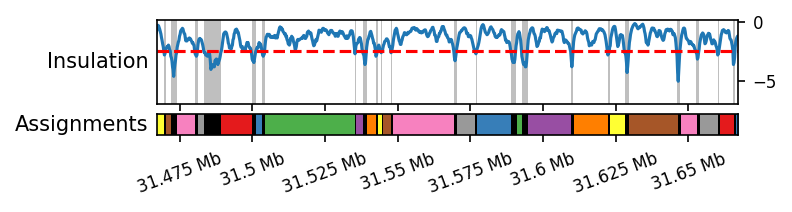

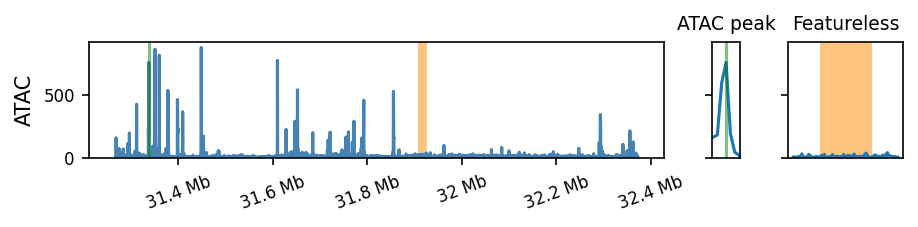

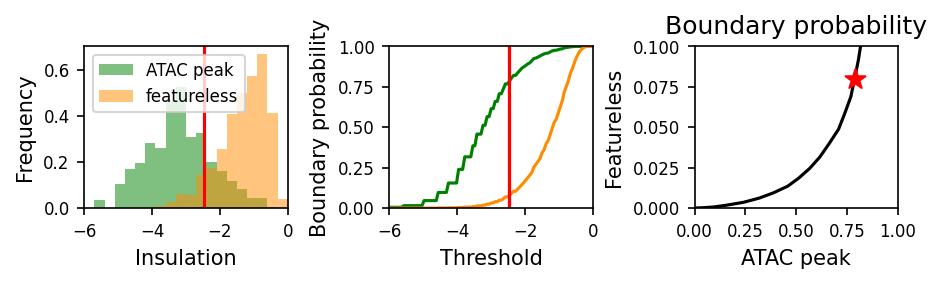

In [20]:
name = 'ppm1g'
region = prod[name]['mei'].mei.config['region']
chrom, start, end = parse_region(region)
ref_map = prod[name]['mei'].get_reference_contact_map()
sim_map = prod[name]['mei'].get_precomputed_contact_map(prod[name]['iteration'])

atac = f'{omics}/genomics_data/GSE98390_E14_ATAC_MERGED.DANPOS.mm39.bw'
atac = load_bw(atac, chrom, start, end)
atac = bin_track(atac, step=200)

w = 10
ins = insulations[name][w].copy()
print('isinf', np.sum(np.isinf(ins)))
ins[np.isinf(ins)] = np.min(ins[~np.isinf(ins)])

cutoff = median_insulation[w] - 1

featureless_index = (3200, 3300)
atac_index = 352

x = np.arange(start, end, 200) + 100

assert len(x) == len(atac) and len(x) == ins.shape[1]

##################################

f, ax = plt.subplots(2, figsize=(5, 1), gridspec_kw={'height_ratios': [4, 1]}, sharex=True)

example = ins[-2].copy()
example_dbscan = domains[name][-2]
mask = example > cutoff
sections = get_segments(mask)
d = Domains(np.zeros((len(sections), 3)), sections)
loops = get_loops(sections)

ax[0].plot(x, example)
ax[0].axhline(cutoff, c='red', ls='--')
ax[0].set_ylabel('Insulation', rotation=0, ha='right', va='center')
ax[0].yaxis.tick_right()
for s, e in loops:
    ax[0].axvspan(x[s], x[e], facecolor='black', edgecolor='none', alpha=0.25)

ax[1].imshow(d.labels.reshape(1, -1), cmap=d.colors(), extent=(x[0], x[-1], 0, 1), interpolation='none', aspect='auto')
ax[1].set_yticks([])
ax[1].set_ylabel('Assignments', rotation=0, ha='right', va='center')

# ax[2].imshow(example_dbscan.labels.reshape(1, -1), cmap=example_dbscan.colors(), extent=(x[0], x[-1], 0, 1), interpolation='none', aspect='auto')
# ax[2].set_yticks([])
# ax[2].set_ylabel('DBSCAN', rotation=0, ha='right', va='center')

format_ticks(ax[1], y=False)
ax[1].set_xlim(x[1000], x[2000])
plt.savefig('img/microdomains_calibration_example.pdf')
plt.show()

###################################
f, ax = plt.subplots(1, 3, figsize=(7, 1), gridspec_kw={'width_ratios': [10, 0.5, 2]}, sharey=True)

ax[0].plot(x, atac, color='steelblue')
ax[0].axvspan(x[featureless_index[0]], x[featureless_index[1]], facecolor='darkorange', alpha=0.5)
ax[0].axvline(x[atac_index], c='green', alpha=0.5)
ax[0].set_ylim(0)
ax[0].set_ylabel('ATAC')
format_ticks(ax[0], y=False)

ax[1].plot(x[atac_index-3:atac_index+4], atac[atac_index-3:atac_index+4])
ax[1].axvline(x[atac_index], c='green', alpha=0.5)
ax[1].set_xticks([])
ax[1].set_title('ATAC peak', size=9)

ax[2].plot(x[featureless_index[0]-50:featureless_index[1]+51], atac[featureless_index[0]-50:featureless_index[1]+51])
ax[2].axvspan(x[featureless_index[0]], x[featureless_index[1]], facecolor='darkorange', alpha=0.5)
ax[2].set_xticks([])
ax[2].set_title('Featureless', size=9)

plt.savefig('img/microdomains_calibration_atac.pdf')
plt.show()

######################################

x1 = ins[:, atac_index]
x2 = ins[:, featureless_index[0]:featureless_index[1]].flatten()

f, ax = plt.subplots(1, 3, figsize=(7, 1.4), gridspec_kw={'wspace':0.5})

bins = np.linspace(-6, 0, 21)
ax[0].hist(x1, density=True, alpha=0.5, bins=bins, label='ATAC peak', facecolor='green')
ax[0].hist(x2, density=True, alpha=0.5, bins=bins, label='featureless', facecolor='darkorange')
ax[0].axvline(cutoff, c='red')
ax[0].legend(fontsize=8)
ax[0].set_xlim(bins[0], bins[-1])
ax[0].set_xlabel('Insulation')
ax[0].set_ylabel('Frequency')

cuts = np.linspace(-6, 0, 101)
cdf1 = np.array([np.mean(x1 < cut) for cut in cuts])
cdf2 = np.array([np.mean(x2 < cut) for cut in cuts])
ax[1].plot(cuts, cdf1, c='green', label='ATAC peak')
ax[1].plot(cuts, cdf2, c='darkorange', label='featureless')
ax[1].axvline(cutoff, c='red')
ax[1].set_ylim(0, 1)
ax[1].set_xlim(cuts[0], cuts[-1])
ax[1].set_xlabel('Threshold')
ax[1].set_ylabel('Boundary probability')
ax[1].axvline(cutoff, c='red')

ax[2].plot(cdf1, cdf2, zorder=0, c='black')
ax[2].scatter(np.mean(x1 < cutoff), np.mean(x2 < cutoff), marker='*', c='red', s=100, zorder=1)
ax[2].set_xlabel('ATAC peak')
ax[2].set_ylabel('Featureless')
ax[2].set_title('Boundary probability')
ax[2].set_ylim(0, 0.1)
ax[2].set_xlim(0, 1)
plt.savefig('img/microdomains_calibration.pdf')
plt.show()

# Insulation domains

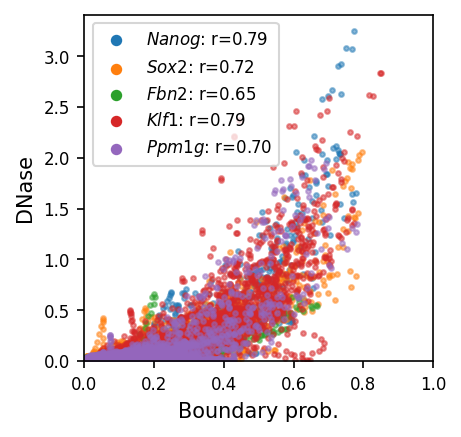

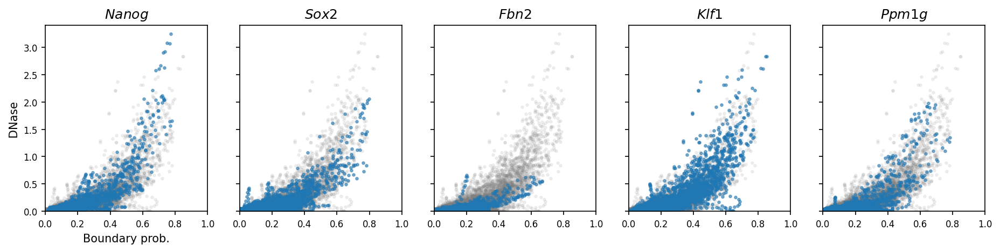

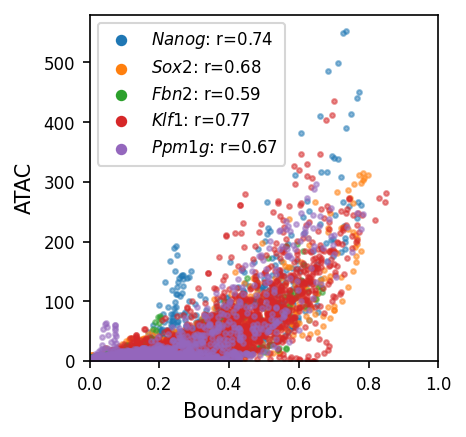

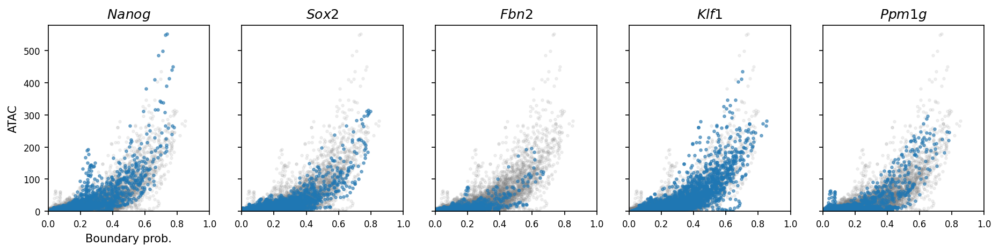

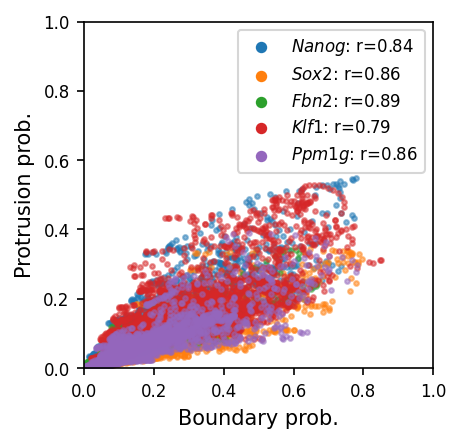

...

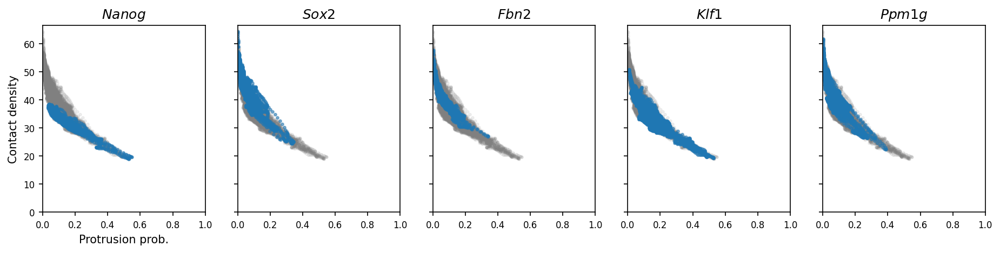

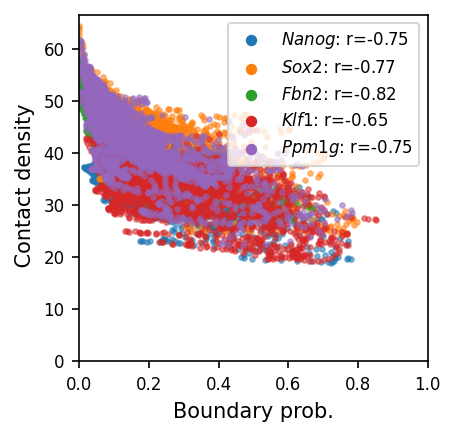

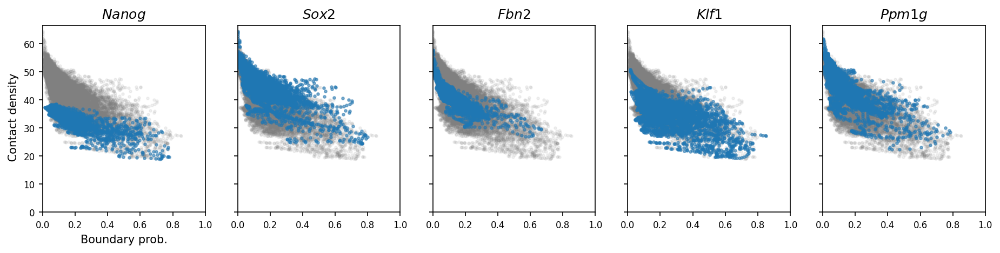

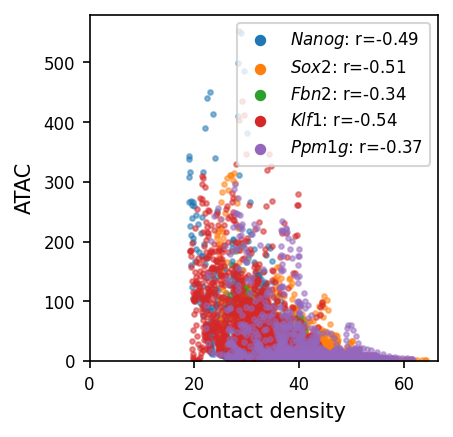

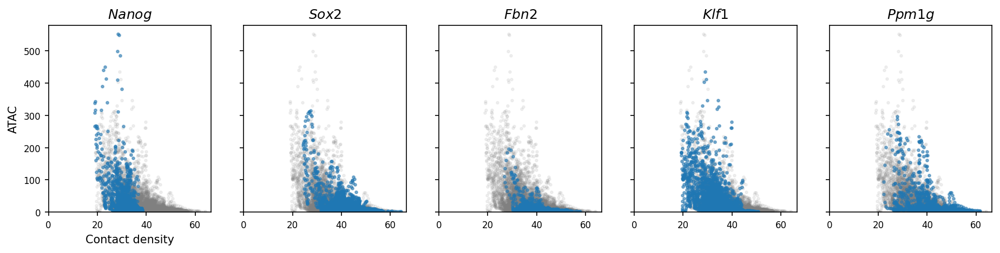

In [8]:
from scipy.stats import pearsonr
from neighbor_balance.ice import get_marginal

def get_atac(name):
    region = prod[name]['mei'].mei.config['region']
    chrom, start, end = parse_region(region)
    atac = f'{omics}/genomics_data/GSE98390_E14_ATAC_MERGED.DANPOS.mm39.bw'
    atac = load_bw(atac, chrom, start, end)
    atac = bin_track(atac, step=200)
    return atac

def get_dnase(name):
    region = prod[name]['mei'].mei.config['region']
    chrom, start, end = parse_region(region)
    dnase = f'{omics}/new_genomics_data/ENCFF672DJH.mm39.bw'
    dnase = load_bw(dnase, chrom, start, end)
    dnase = bin_track(dnase, step=200)
    return dnase

def get_protrusions(name):
    return np.mean([d.labels == -1 for d in domains[name]], axis=0)

def get_insulation_boundaries(name):
    return np.mean([d.labels == -1 for d in domains_ins[name]], axis=0)

def get_density(name):
    ref_map = prod[name]['mei'].get_reference_contact_map()
    return 2*get_marginal(ref_map)


def process(track):
    buf = 50_000 // 200
    bw = 2.5
    return gaussian_filter1d(track, bw)[buf:-buf]

def scatter_metrics_together(metric1_name, metric2_name, metric1, metric2):
    f, ax = plt.subplots(figsize=(3, 3))
    for name in main_names:
        feature1 = metric1(name)
        feature2 = metric2(name)
    
        feature1 = process(feature1)
        feature2 = process(feature2)
    
        r, _ = pearsonr(feature1, feature2)
        sc = ax.scatter(feature1, feature2, alpha=0.5, s=5)
        ax.scatter([], [], color=sc.get_facecolor()[0], s=20, label=f'{stylized_names[name]}: r={r:.2f}', alpha=1)

    ax.legend()
    if 'prob' in metric1_name:
        ax.set_xlim(0, 1)
    else:
        ax.set_xlim(0)
    if 'prob' in metric2_name:
        ax.set_ylim(0, 1)
    else:
        ax.set_ylim(0)
    ax.set_xlabel(metric1_name)
    ax.set_ylabel(metric2_name)
    return ax

def scatter_metrics_separate(metric1_name, metric2_name, metric1, metric2):
    f, axs = plt.subplots(1, len(main_names), figsize=(3*len(main_names), 3), sharex=True, sharey=True)
    for name in main_names:
        feature1 = metric1(name)
        feature2 = metric2(name)

        feature1 = process(feature1)
        feature2 = process(feature2)
        for ax in axs:
            ax.scatter(feature1, feature2, alpha=0.1, s=5, color='gray')

    for i, name in enumerate(main_names):
        feature1 = metric1(name)
        feature2 = metric2(name)
    
        feature1 = process(feature1)
        feature2 = process(feature2)
    
        r, _ = pearsonr(feature1, feature2)
        sc = axs[i].scatter(feature1, feature2, alpha=0.5, s=5)
        axs[i].set_title(stylized_names[name])

    if 'prob' in metric1_name:
        axs[0].set_xlim(0, 1)
    else:
        axs[0].set_xlim(0)
    if 'prob' in metric2_name:
        axs[0].set_ylim(0, 1)
    else:
        axs[0].set_ylim(0)
    
    axs[0].set_xlabel(metric1_name)
    axs[0].set_ylabel(metric2_name)


def scatter_metrics(metric1_name, metric2_name, metric1, metric2):
    ax = scatter_metrics_together(metric1_name, metric2_name, metric1, metric2)
    
    plt.savefig(f'img/scatter_together_{metric1_name}_{metric2_name}.pdf')
    plt.show()

    scatter_metrics_separate(metric1_name, metric2_name, metric1, metric2)
    plt.savefig(f'img/scatter_separate_{metric1_name}_{metric2_name}.pdf')
    plt.show()

scatter_metrics('Boundary prob.', 'DNase', get_insulation_boundaries,  get_dnase)
scatter_metrics('Boundary prob.', 'ATAC', get_insulation_boundaries,  get_atac)
scatter_metrics('Boundary prob.', 'Protrusion prob.', get_insulation_boundaries, get_protrusions)
scatter_metrics('Protrusion prob.', 'ATAC', get_protrusions, get_atac)
scatter_metrics('Protrusion prob.', 'Contact density', get_protrusions, get_density)
scatter_metrics('Boundary prob.', ' Contact density', get_insulation_boundaries, get_density)
scatter_metrics('Contact density', 'ATAC', get_density, get_atac)

nanog


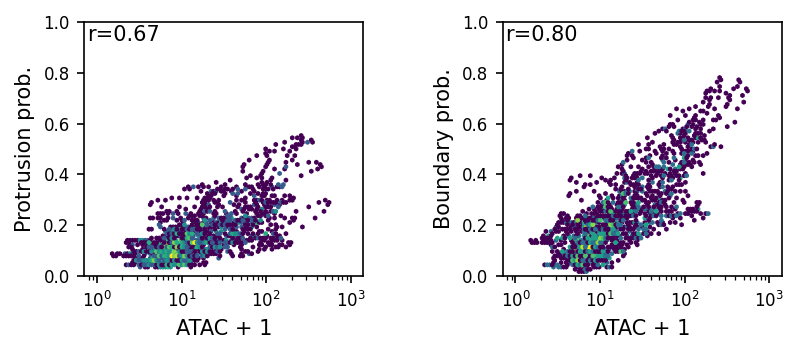

klf1


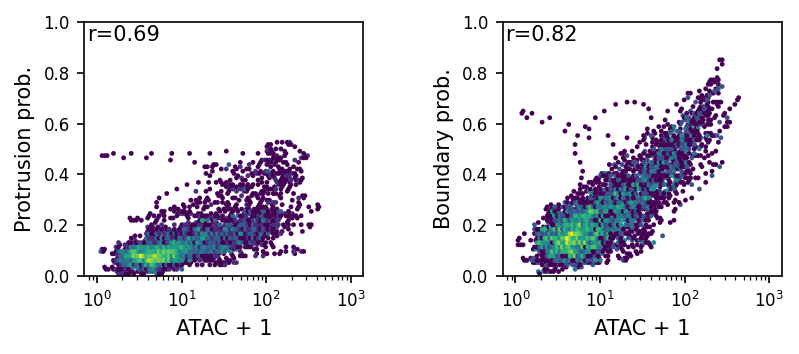

ppm1g


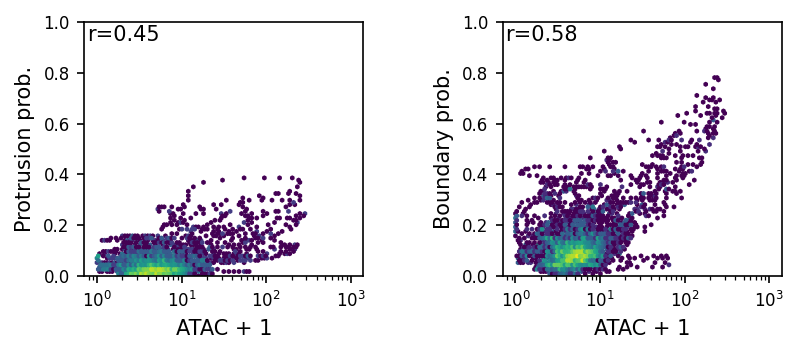

ppm1g_ice


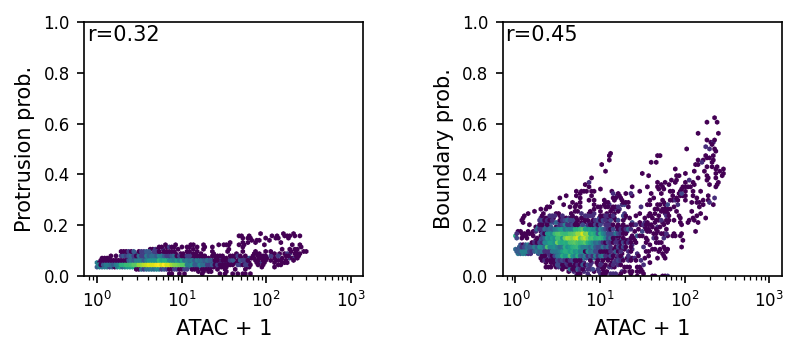

ppm1g_rad21_aid


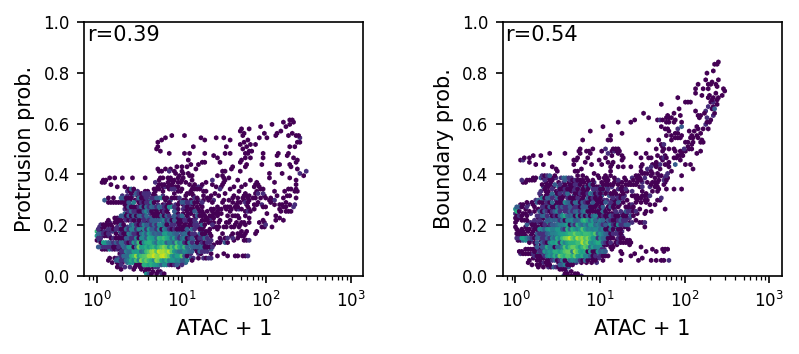

sox2


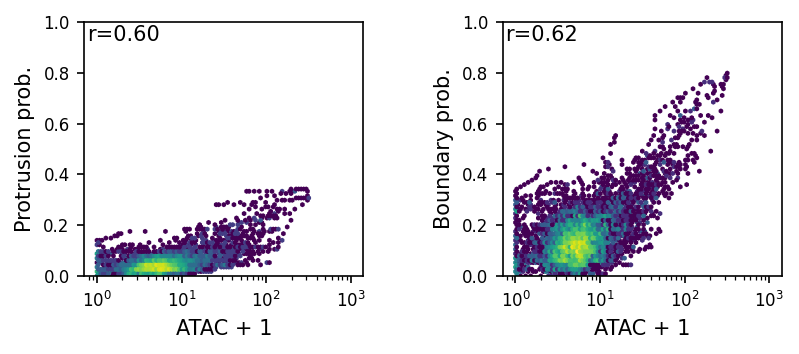

fbn2


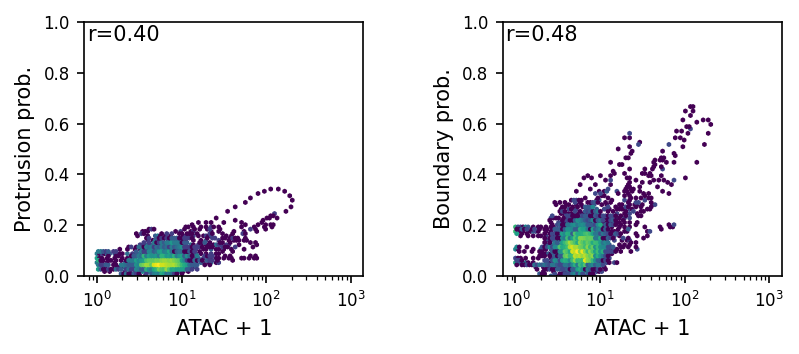

In [22]:
def scatter_individual(name):
    atac = process(get_atac(name))
    protrusions = process(get_protrusions(name))
    boundaries = process(get_insulation_boundaries(name))

    f, ax = plt.subplots(1, 2, figsize=(6, 2.2), gridspec_kw={'wspace': 0.5})
    ax[0].hexbin(1 + atac, protrusions, norm=LogNorm(), extent=(0, 3, 0, 1), bins=50, xscale='log')
    ax[0].text(0.01, 0.99, f'r={pearsonr(protrusions, np.log(1 + atac))[0]:.2f}', transform=ax[0].transAxes, ha='left', va='top')
    ax[0].set_ylim(0, 1)
    ax[0].set_ylabel('Protrusion prob.')
    ax[0].set_xlabel('ATAC + 1')
    #ax[0].set_aspect('equal')

    ax[1].hexbin(1 + atac, boundaries, norm=LogNorm(), extent=(0, 3, 0, 1), bins=50, xscale='log')
    ax[1].text(0.01, 0.99, f'r={pearsonr(boundaries, np.log(1 + atac))[0]:.2f}', transform=ax[1].transAxes, ha='left', va='top')
    ax[1].set_ylim(0, 1)
    #ax[1].set_xlim(1e0, 1e3)
    ax[1].set_ylabel('Boundary prob.')
    ax[1].set_xlabel('ATAC + 1')
    
    plt.savefig(f'img/microdomains_corr_{name}.pdf')
    plt.show()

for name in prod:
    print(name)
    scatter_individual(name)

# Plots for full regions

In [23]:
import cooler
import bioframe
import cooltools

def compute_compartments(cool, fasta, chrom, res):
    clr = cooler.Cooler(f'{cool}::/resolutions/{res}')
    start = 0
    end = clr.chromsizes[chrom]
    bins = clr.bins()[:]
    bins = bins.loc[bins.chrom == chrom]
    genome = bioframe.load_fasta(fasta)
    gc_cov = bioframe.frac_gc(bins[['chrom', 'start', 'end']], genome)
    cis_eigs = cooltools.eigs_cis(clr, phasing_track=gc_cov, view_df=pd.DataFrame({'chrom': [chrom], 'start': [start], 'end': [end], 'name': [chrom]}), n_eigs=1)
    return np.arange(start, end, res), cis_eigs[1]['E1']

def plot_compartments(ab_x, ab, ax):
    ax.fill_between(ab_x, 0, np.maximum(0, ab), color='green', edgecolor='none')
    ax.fill_between(ab_x, 0, np.minimum(0, ab), color='red', edgecolor='none')

In [24]:
root = '/home/joepaggi/share'
cool = f'{root}/microc/hsieh/GSE130275_mESC_WT/GSE130275_mESC_WT_minus_inward.mcool'
fasta = f'{root}/ucsc/mm39.fa'
compartments = {}
for name in domains:
    print(name)
    region = prod[name]['mei'].mei.config['region']
    chrom, start, end = parse_region(region)
    compartments[chrom] = compute_compartments(cool, fasta, chrom, 12_800)

nanog


/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/bioframe/extras.py:316: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  agg = df.groupby("chrom", sort=False)[["start", "end"]].apply(_each)
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/cooltools/lib/checks.py:550: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for name, group in track.groupby(track.columns[0]):
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/cooltools/lib/common.py:489: UserWarning: less than 50% of valid bins have been assigned a value
  warnings.warn("less than 50% of valid bins h

klf1


/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/bioframe/extras.py:316: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  agg = df.groupby("chrom", sort=False)[["start", "end"]].apply(_each)
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/cooltools/lib/checks.py:550: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for name, group in track.groupby(track.columns[0]):
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/cooltools/lib/common.py:489: UserWarning: less than 50% of valid bins have been assigned a value
  warnings.warn("less than 50% of valid bins h

ppm1g


/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/bioframe/extras.py:316: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  agg = df.groupby("chrom", sort=False)[["start", "end"]].apply(_each)
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/cooltools/lib/checks.py:550: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for name, group in track.groupby(track.columns[0]):
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/cooltools/lib/common.py:489: UserWarning: less than 50% of valid bins have been assigned a value
  warnings.warn("less than 50% of valid bins h

ppm1g_ice


/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/bioframe/extras.py:316: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  agg = df.groupby("chrom", sort=False)[["start", "end"]].apply(_each)
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/cooltools/lib/checks.py:550: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for name, group in track.groupby(track.columns[0]):
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/cooltools/lib/common.py:489: UserWarning: less than 50% of valid bins have been assigned a value
  warnings.warn("less than 50% of valid bins h

ppm1g_rad21_aid


/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/bioframe/extras.py:316: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  agg = df.groupby("chrom", sort=False)[["start", "end"]].apply(_each)
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/cooltools/lib/checks.py:550: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for name, group in track.groupby(track.columns[0]):
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/cooltools/lib/common.py:489: UserWarning: less than 50% of valid bins have been assigned a value
  warnings.warn("less than 50% of valid bins h

sox2


/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/bioframe/extras.py:316: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  agg = df.groupby("chrom", sort=False)[["start", "end"]].apply(_each)
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/cooltools/lib/checks.py:550: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for name, group in track.groupby(track.columns[0]):
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/cooltools/lib/common.py:489: UserWarning: less than 50% of valid bins have been assigned a value
  warnings.warn("less than 50% of valid bins h

fbn2


/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/bioframe/extras.py:316: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  agg = df.groupby("chrom", sort=False)[["start", "end"]].apply(_each)
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/cooltools/lib/checks.py:550: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for name, group in track.groupby(track.columns[0]):
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/cooltools/lib/common.py:489: UserWarning: less than 50% of valid bins have been assigned a value
  warnings.warn("less than 50% of valid bins h

nanog


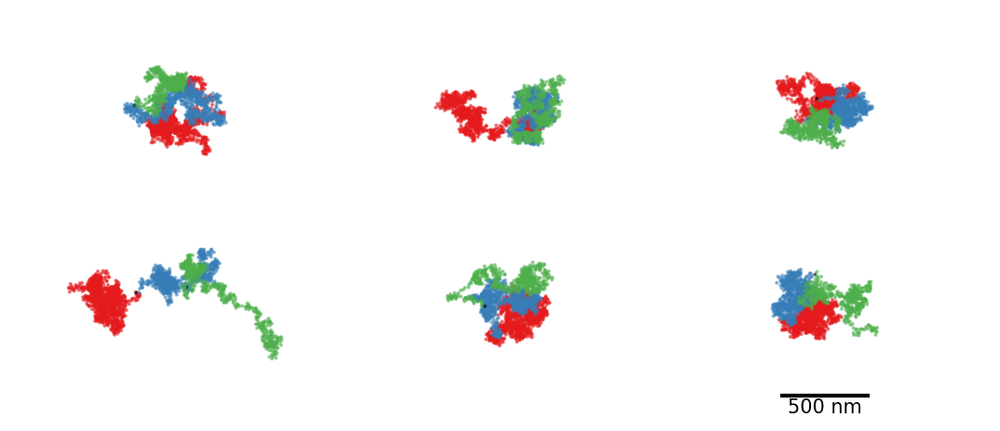

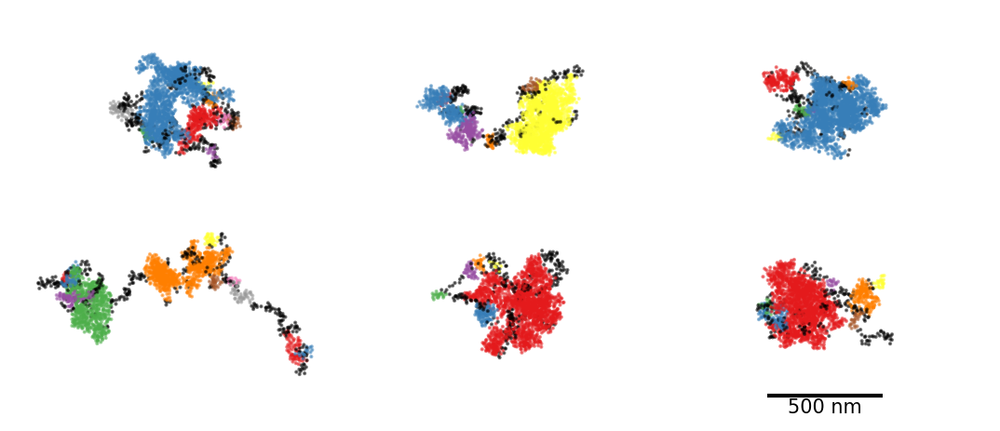

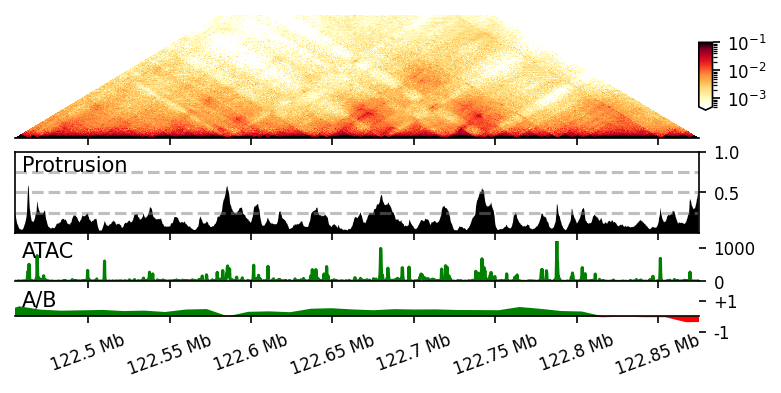

klf1


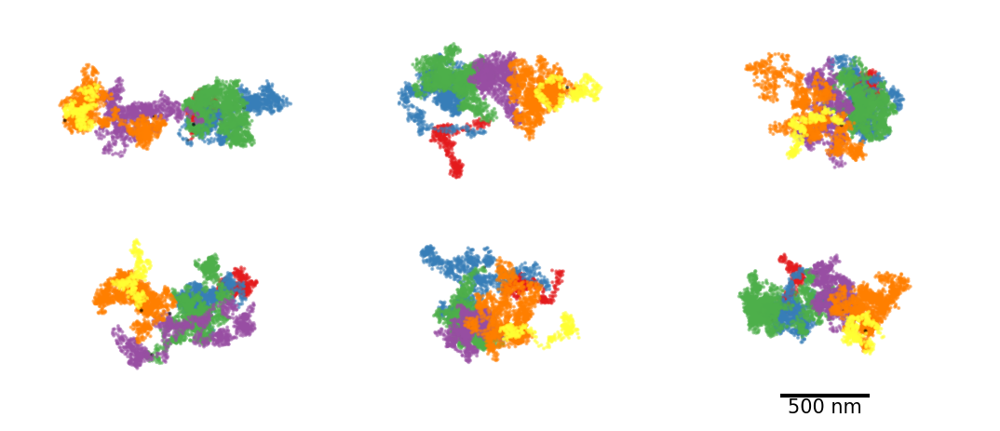

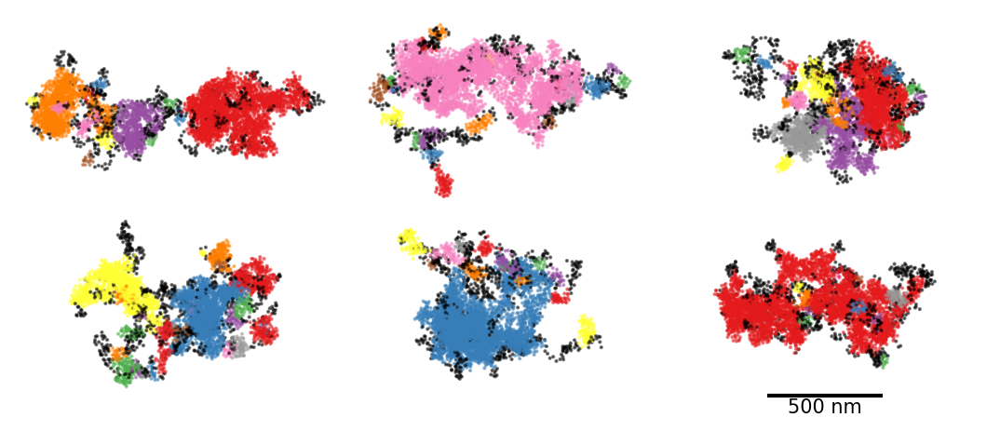

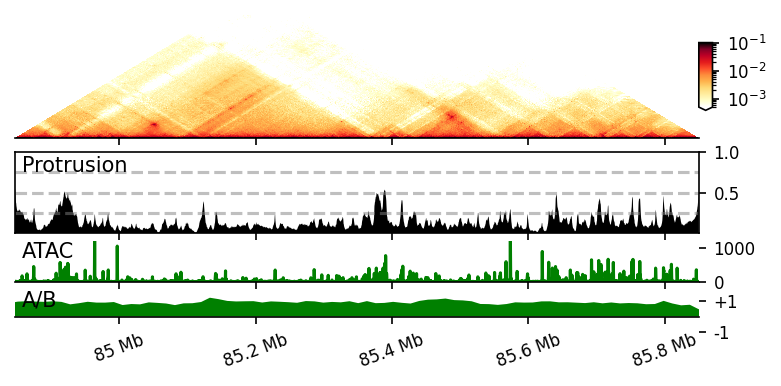

ppm1g


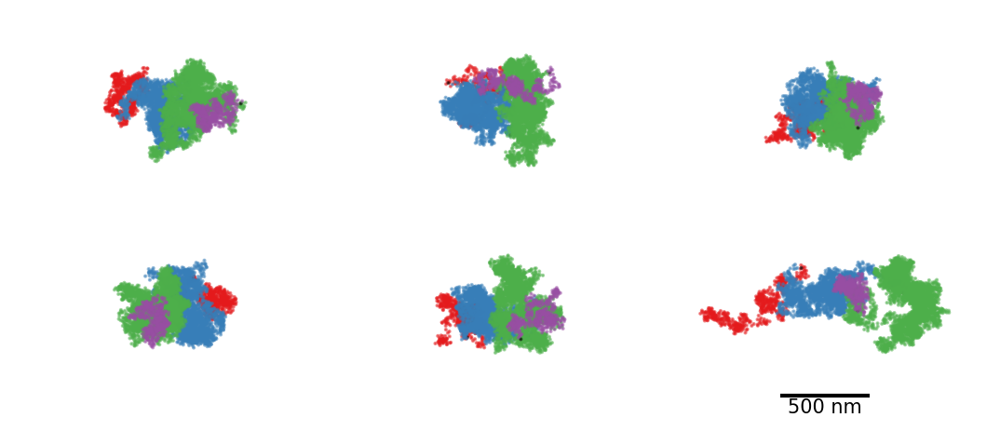

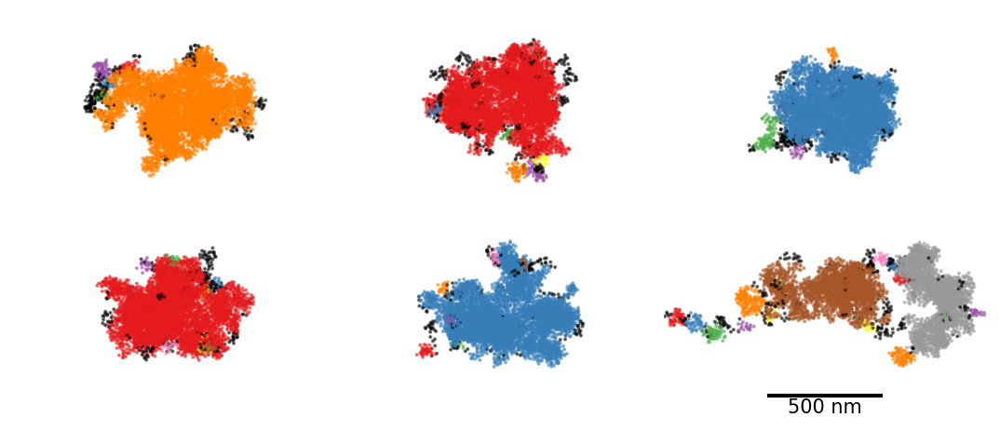

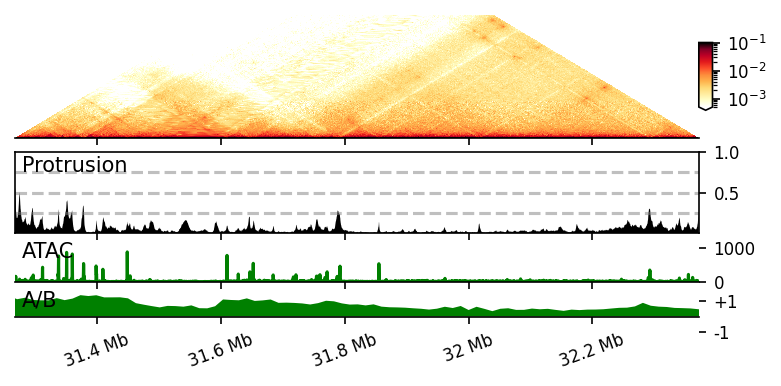

ppm1g_ice


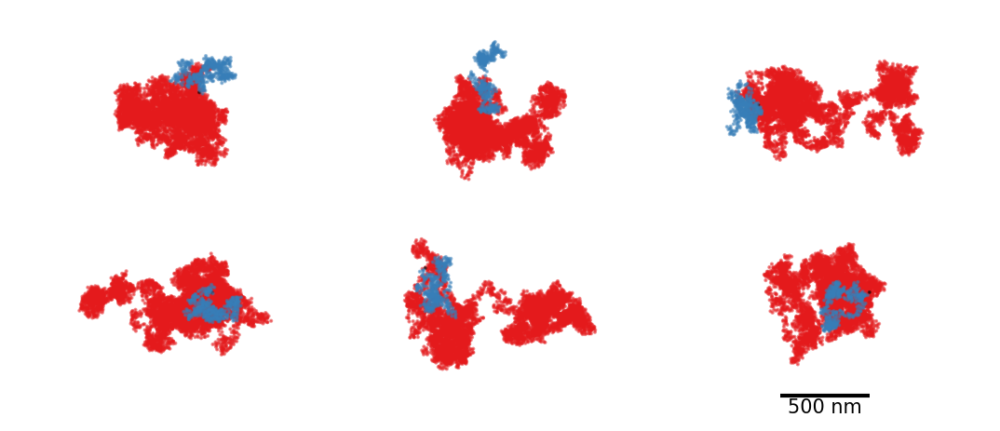

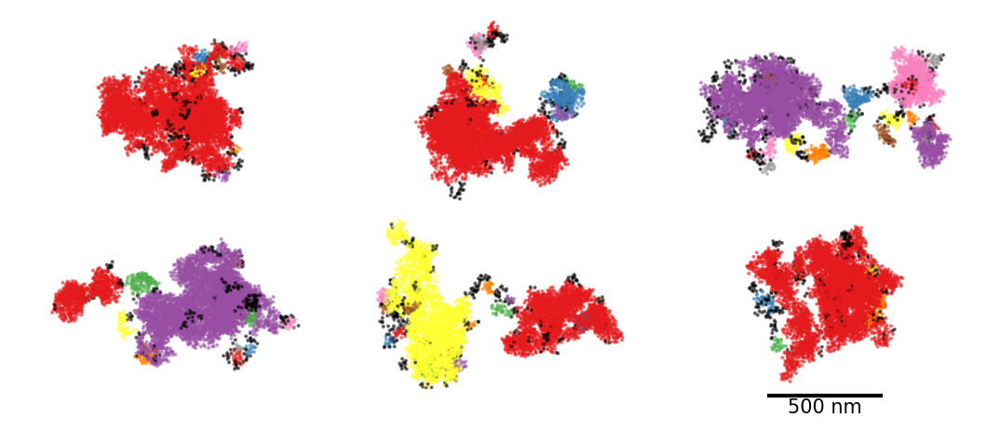

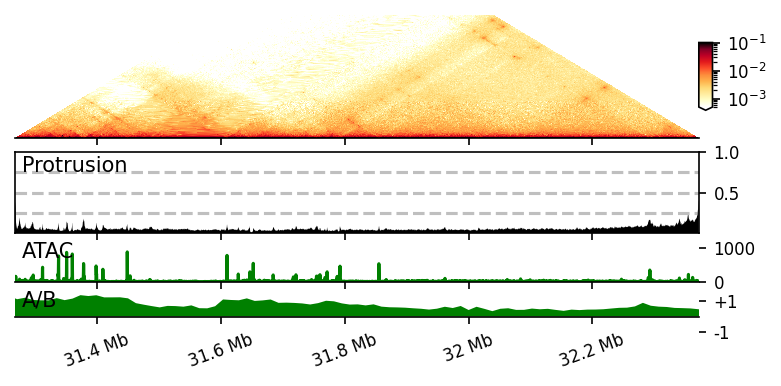

ppm1g_rad21_aid


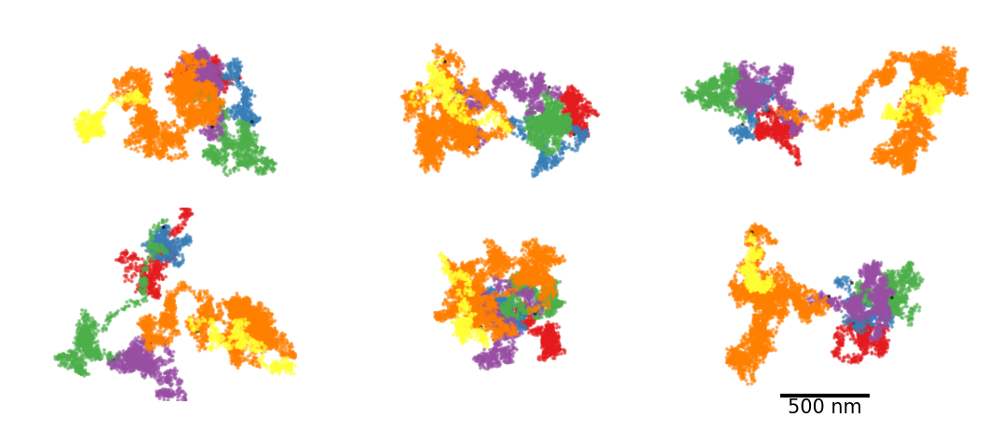

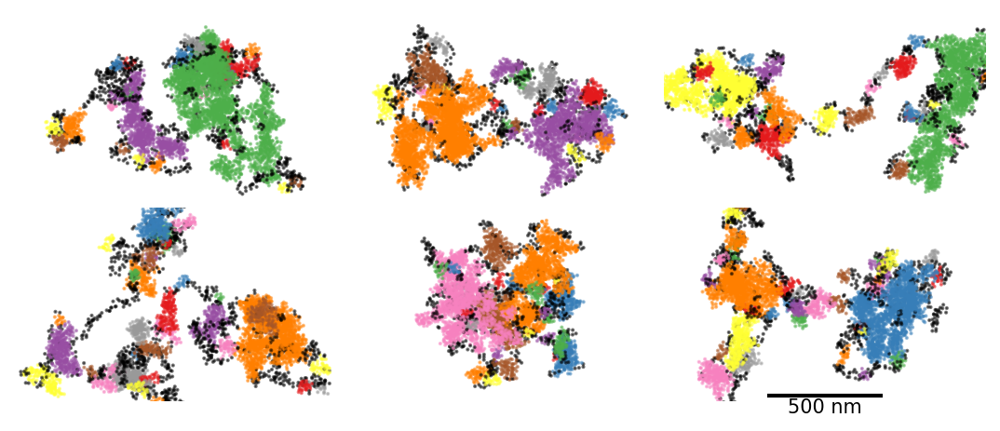

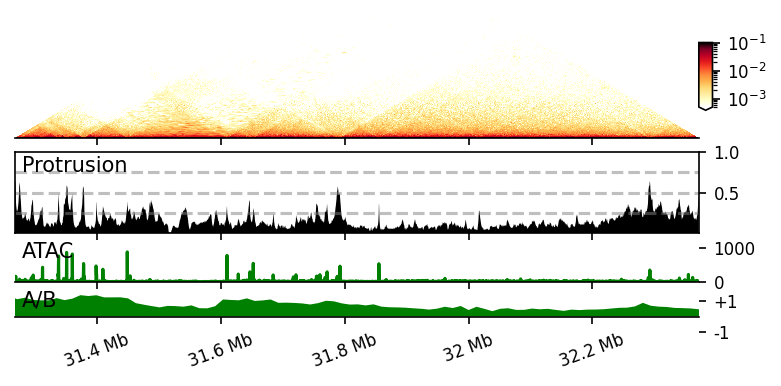

sox2


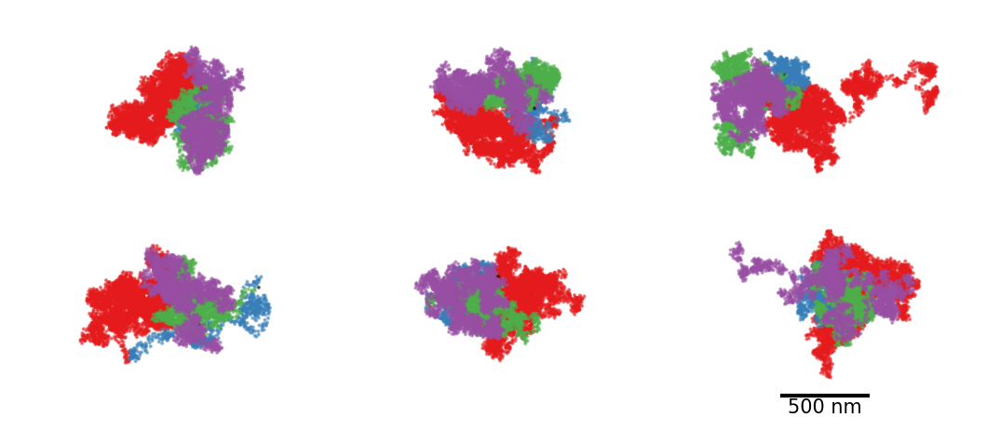

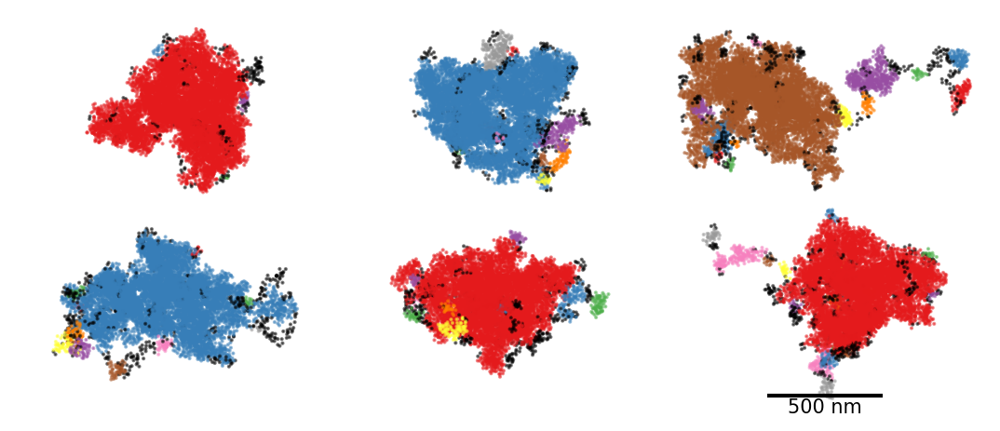

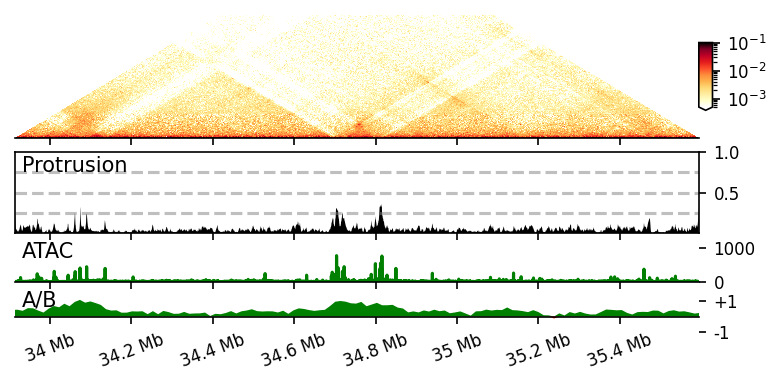

fbn2


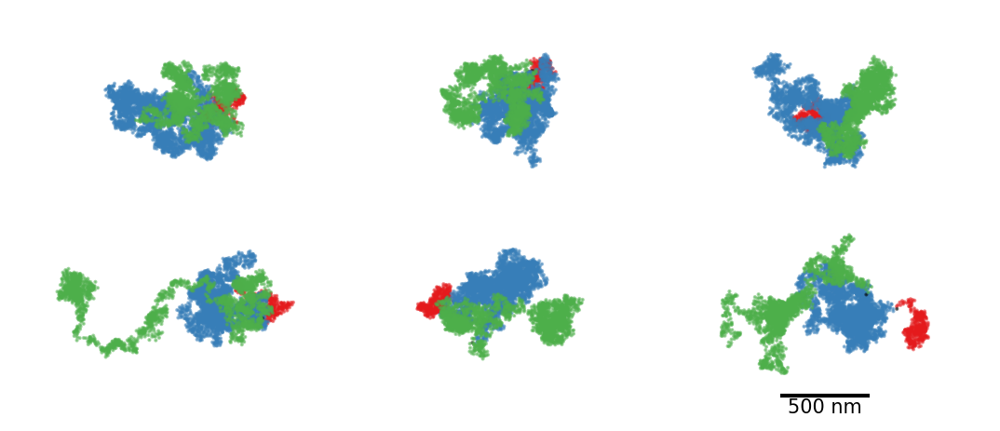

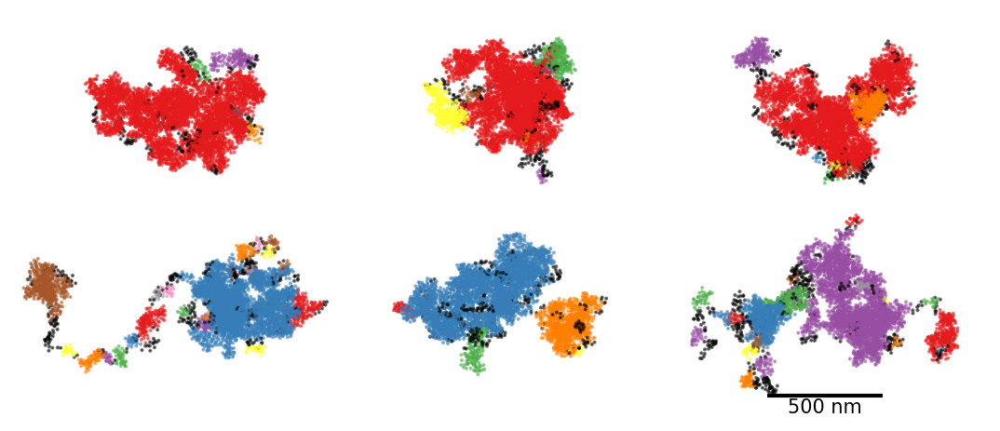

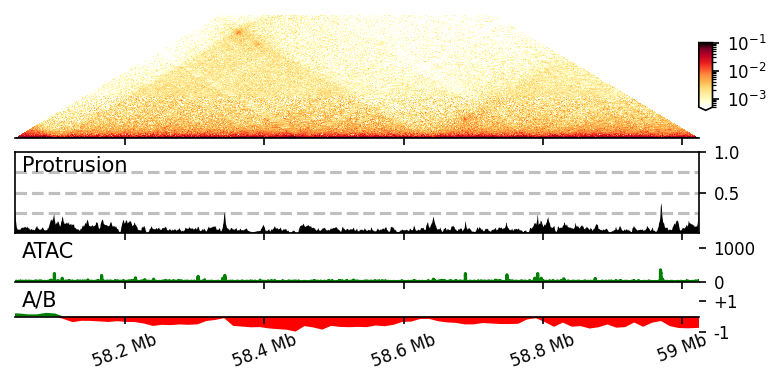

In [25]:
for name in domains:
    print(name)
    region = prod[name]['mei'].mei.config['region']
    chrom, start, end = parse_region(region)
    ref_map = prod[name]['mei'].get_reference_contact_map()

    w = 250
    vmin = 5e-4
    vmax = 1e-1
    examples = 6

    ref_insulation_scores = np.log2(_insul_diamond_dense(ref_map, window=w, norm_by_median=False))
    boundaries = get_boundaries(mask_insulation_scores(ref_insulation_scores[None, :]), threshold=0.5)
    sections = get_sections(len(ref_insulation_scores), boundaries)[0]
    for b in boundaries[0]:
        sections[b] = -1

    dbscan = domains[name][::len(domains[name])//examples][:examples]
    refs = []
    
    for domain in dbscan:
        refs += [Domains(domain.positions, sections.astype(int))]

    plot_gallery_list(refs, lambda x, ax: x.plot_2D(ax=ax, colorbar=False, s=1, alpha=0.5), scalebar=500, size=900, rows=2)
    plt.savefig(f'img/gallery_{name}.pdf')
    plt.show()
    
    plot_gallery_list(dbscan, lambda x, ax: x.plot_2D(ax=ax, colorbar=False, s=1, alpha=0.5), scalebar=500, size=700, rows=2)
    plt.savefig(f'img/gallery_dbscan_{name}.pdf')
    plt.show()
    
    atac = f'{omics}/genomics_data/GSE98390_E14_ATAC_MERGED.DANPOS.mm39.bw'
    atac = load_bw(atac, chrom, start, end)
    atac = bin_track(atac, step=200)

    n_tracks = 3
    f, ax = plt.subplots(1 + n_tracks, 2, figsize=(6, 2.9), sharex='col', constrained_layout=False,
                         gridspec_kw={'height_ratios':[5]+[3, 1.5, 2], 'width_ratios': [1, 0.02], 'wspace': 0.0, 'hspace': 0.1})
    x = np.arange(start, end, 200)

    # Show the contact map.
    contact_map = ContactMap(ref_map, chrom=chrom, start=start, end=end, resolution=200)
    im = contact_map.plot_contact_map_horizontal(depth=(end-start)*0.6, vmin=vmin, vmax=vmax, ax=ax[0, 0], colorbar=False)
    ax[0, 0].set_aspect(0.3)
    plt.colorbar(im, cax=ax[0, 1], extend='min')
    pos = ax[0, 1].get_position()
    shrink = 1/2
    ax[0, 1].set_position([pos.x0, pos.y0 + pos.height * (1 - shrink) / 2, pos.width, pos.height*shrink])
    i = 1
    ax[0, 0].spines[['top', 'left', 'right']].set_visible(False)
    ax[0, 0].set_yticks([])

    # Normal loop prob.
    ax[i, 0].text(0.01, 0.95, 'Protrusion', transform=ax[i, 0].transAxes, ha='left', va='top')
    p_loop = np.mean([d.labels == -1 for d in domains[name]], axis=0)
    ax[i, 0].fill_between(np.arange(start, end, 200), 0, p_loop, facecolor='black', edgecolor='none')
    ax[i, 0].set_ylim(0, 1)
    ax[i, 0].set_yticks([0.5, 1])
    for y in [0.25, 0.5, 0.75]:
        ax[i, 0].axhline(y, c='gray', ls='--', alpha=0.5)
    i += 1

    # ATAC
    ax[i, 0].text(0.01, 0.99, 'ATAC', transform=ax[i, 0].transAxes, ha='left', va='top')
    ax[i, 0].plot(x, atac, c='g')
    ax[i, 0].set_ylim(0, 1200)
    ax[i, 0].spines[['top', 'left', 'right']].set_visible(False)
    i += 1
    
    # A/B
    ab_x, ab = compartments[chrom]
    ax[i, 0].text(0.01, 0.99, 'A/B', transform=ax[i, 0].transAxes, ha='left', va='top')
    plot_compartments(ab_x, ab, ax[i, 0])
    ax[i, 0].set_ylim(-1.75, 1.75)
    ax[i, 0].set_yticks([-1, 1], ['-1', '+1'])
    ax[i, 0].spines[['top', 'left', 'right']].set_visible(False)
    ax[i, 0].spines['bottom'].set_position('center')
    i += 1

    # Clean up axes
    format_ticks(ax[-1, 0], y=False)
    ax[0, 0].set_xlim(start, end)
    for i in range(1, len(ax)):
        ax[i, 1].axis('off')
        ax[i, 0].yaxis.tick_right()
    plt.savefig(f'img/insulation_{name}.pdf')
    plt.show()

# DBSCAN domains are stochastic

nanog


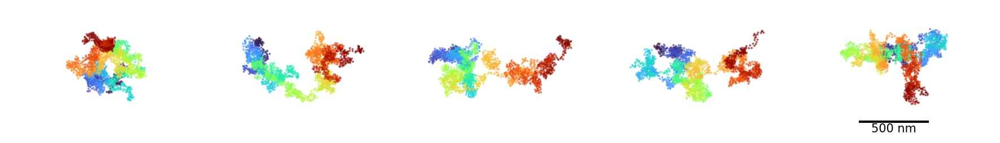

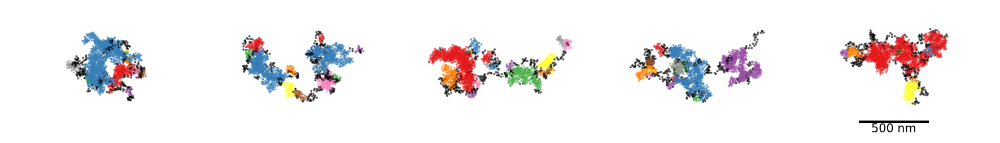

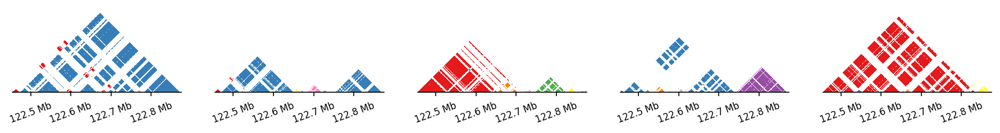

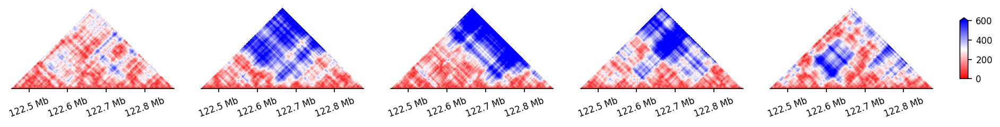

klf1


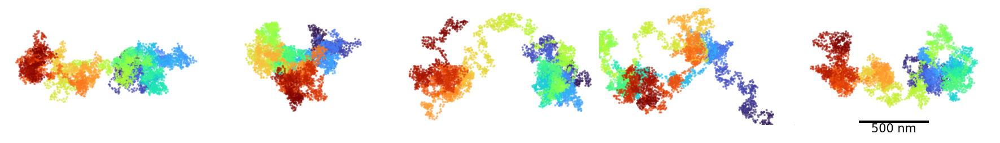

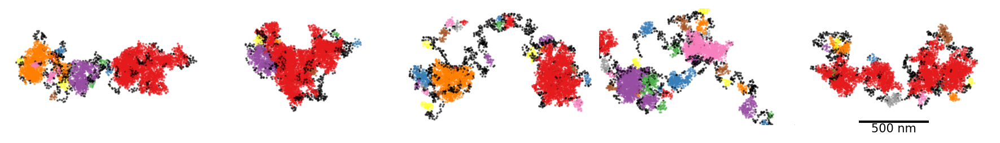

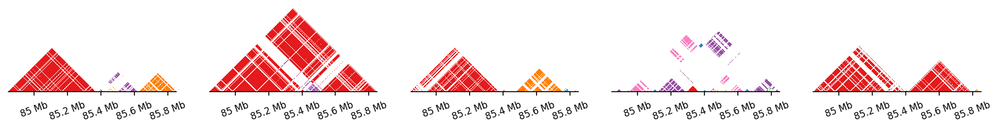

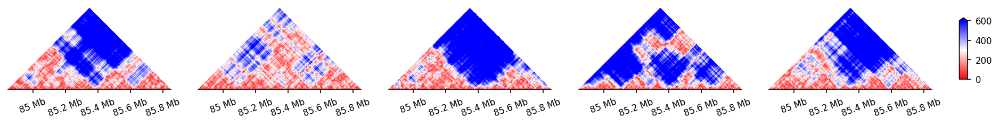

ppm1g


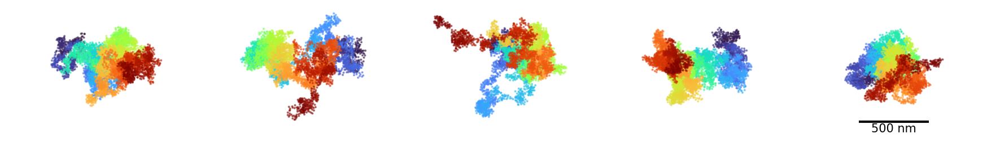

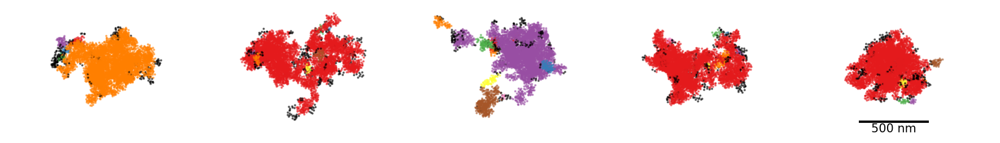

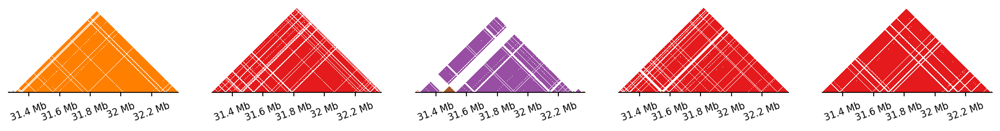

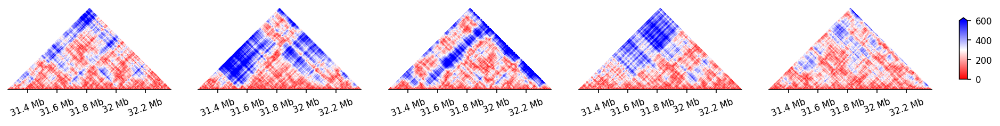

ppm1g_ice


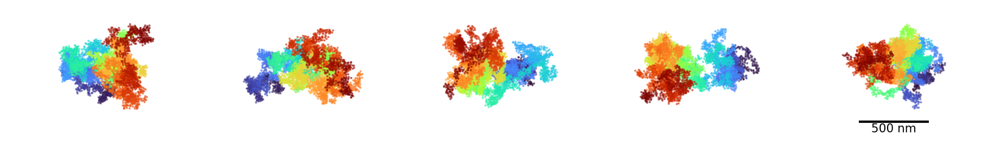

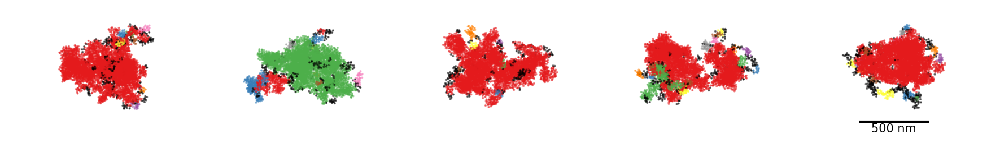

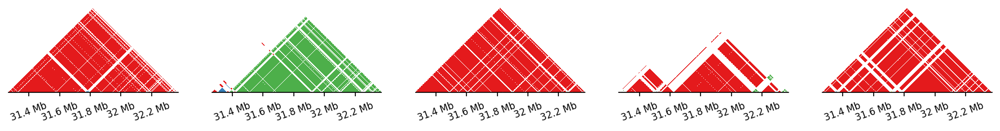

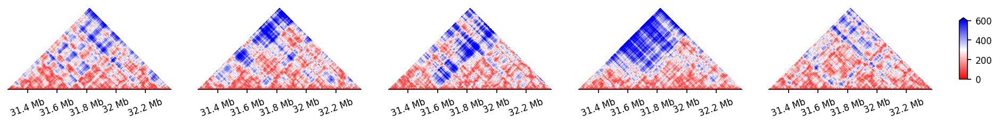

ppm1g_rad21_aid


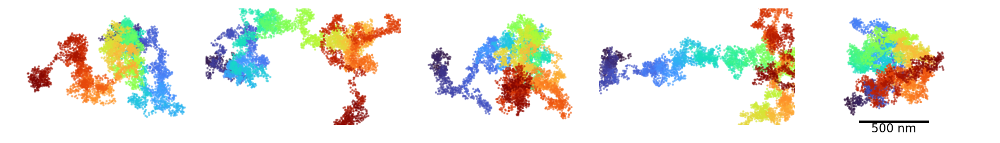

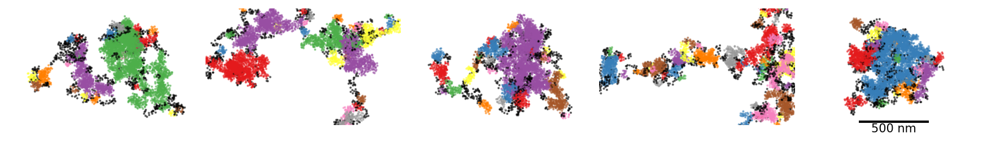

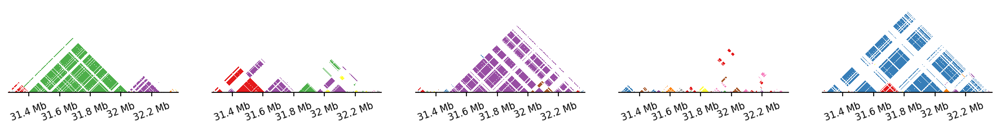

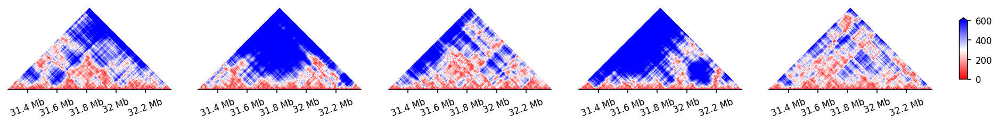

sox2


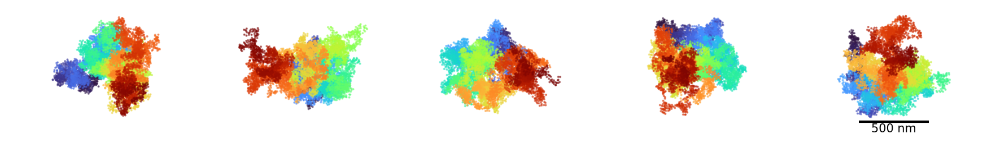

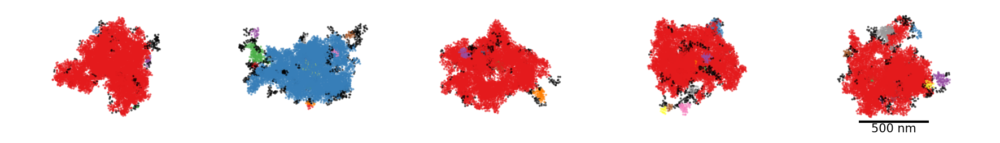

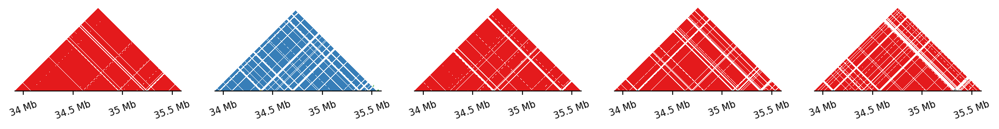

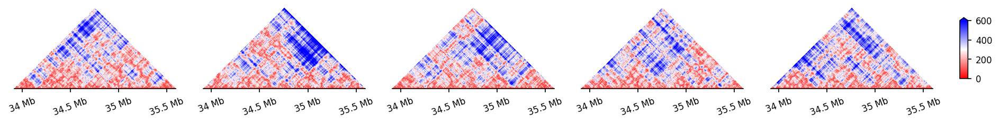

fbn2


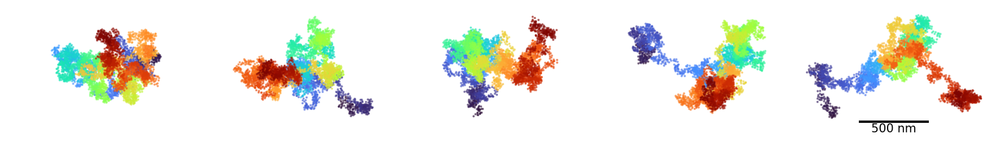

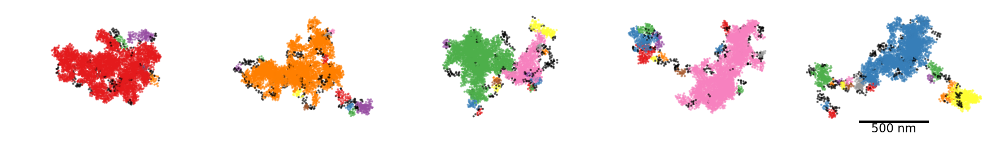

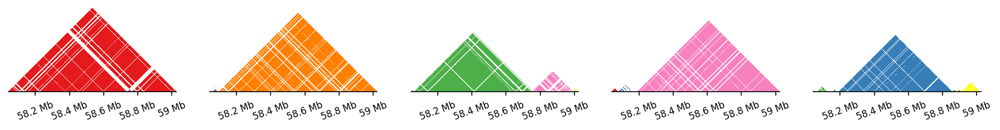

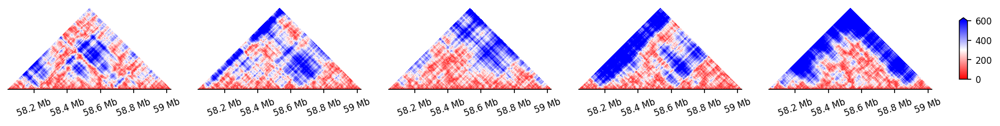

In [26]:
def coarse_grain_map(x, factor=4, average=np.median):
    n = x.shape[0]
    n_cut = factor * (n // factor)
    x = x[:n_cut, :n_cut]
    return average(x.reshape(n_cut // factor, factor, n_cut // factor, factor), axis=(1, 3))

for name in domains:
    print(name)
    region = prod[name]['mei'].mei.config['region']
    chrom, start, end = parse_region(region)
    ref_map = prod[name]['mei'].get_reference_contact_map()

    w = 250
    vmin = 5e-4
    vmax = 1e-1
    examples = 5

    ref_insulation_scores = np.log2(_insul_diamond_dense(ref_map, window=w, norm_by_median=False))
    boundaries = get_boundaries(mask_insulation_scores(ref_insulation_scores[None, :]), threshold=0.5)
    sections = get_sections(len(ref_insulation_scores), boundaries)[0]
    for b in boundaries[0]:
        sections[b] = -1

    dbscan = domains[name][::len(domains[name])//examples][:examples]
    refs = []
    
    for domain in dbscan:
        refs += [Domains(domain.positions, sections.astype(int))]

    plot_gallery_list(dbscan, lambda x, ax: x.plot_chain_2D(ax=ax, colorbar=False, s=1, alpha=0.5), scalebar=500, size=700, rows=1)
    plt.savefig(f'img/stochastic_gallery_chain_{name}.pdf')
    plt.show()
        
    plot_gallery_list(dbscan, lambda x, ax: x.plot_2D(ax=ax, colorbar=False, s=1, alpha=0.5), scalebar=500, size=700, rows=1)
    plt.savefig(f'img/stochastic_gallery_dbscan_{name}.pdf')
    plt.show()

    f, axs = plt.subplots(1, examples, figsize=(3*examples, 2), sharex=True, sharey=True)
    axs = axs.flatten()
    for ax, domain in zip(axs, dbscan):
        color = np.stack([domain.labels]*domain.positions.shape[0], axis=0)
        same = domain.labels[:, None] == domain.labels[None, :]
        color[~same] = -1
        factor = 5
        color = coarse_grain_map(color, factor=factor)
        contact_map = ContactMap(color, chrom=chrom, start=start, end=end, resolution=200*factor)
        contact_map.plot_contact_map_horizontal(cmap=domain.colors(noise_color='white'), ax=ax, colorbar=False, vmin=None, vmax=None, log_norm=False)
        ax.spines[['top', 'left', 'right']].set_visible(False)
        ax.set_yticks([])

        #plt.colorbar(im)
    plt.savefig(f'img/stochastic_dbscan_{name}.pdf')
    plt.show()
    
    f, axs = plt.subplots(1, examples+1, figsize=(3*examples+0.5, 2),
                         gridspec_kw={'width_ratios': [1]*examples + [0.05]})
    axs = axs.flatten()
    for ax, domain in zip(axs, dbscan):
        dists = get_distance_matrix(domain.positions)
        factor = 5
        dists = coarse_grain_map(dists, factor=factor)
        contact_map = ContactMap(dists, chrom=chrom, start=start, end=end, resolution=200*factor)
        im = contact_map.plot_contact_map_horizontal(cmap='bwr_r', vmin=0, vmax=600, colorbar=False, log_norm=False, ax=ax)
        ax.spines[['top', 'left', 'right']].set_visible(False)
        ax.set_yticks([])

    cax = axs[-1]
    plt.colorbar(im, cax=cax, extend='max')
    pos = cax.get_position()
    shrink = 1/2
    cax.set_position([pos.x0, pos.y0 + pos.height * (1 - shrink) / 2, pos.width, pos.height*shrink])
    plt.savefig(f'img/stochastic_dists_{name}.pdf')
    plt.show()

nanog


100%|██████████| 1600/1600 [00:03<00:00, 499.77it/s]


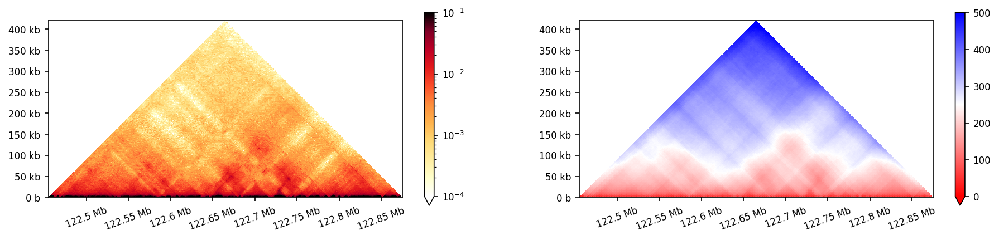

klf1


100%|██████████| 1600/1600 [00:13<00:00, 115.56it/s]


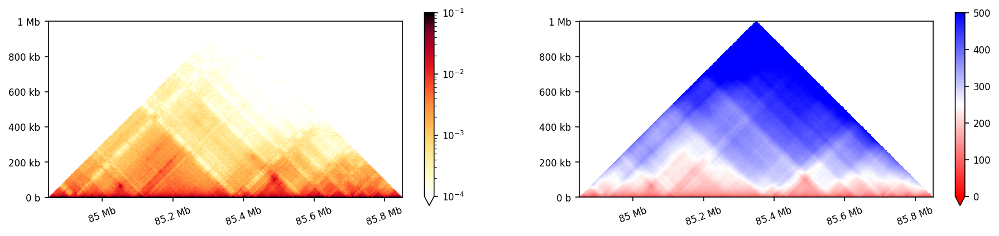

ppm1g


100%|██████████| 1600/1600 [00:16<00:00, 95.80it/s]


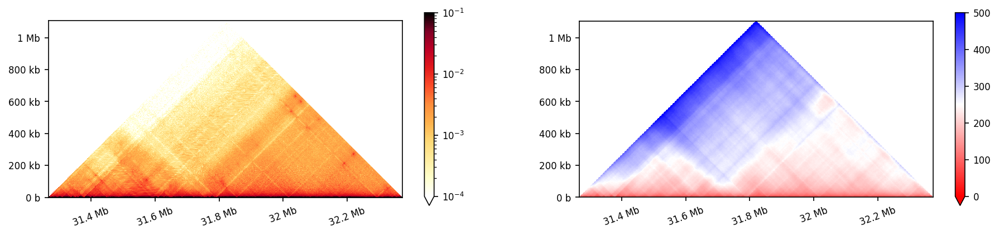

ppm1g_ice


 21%|██        | 330/1600 [00:03<00:12, 99.04it/s]

100%|██████████| 1600/1600 [00:16<00:00, 95.07it/s]


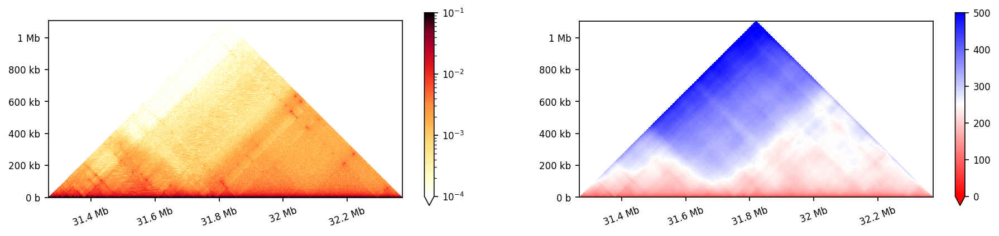

ppm1g_rad21_aid


100%|██████████| 1600/1600 [00:17<00:00, 93.55it/s]


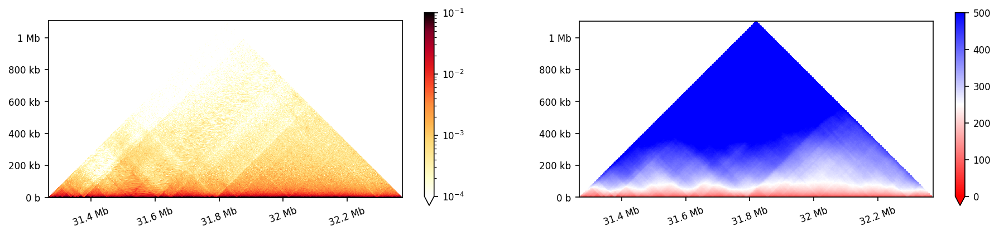

sox2


100%|██████████| 1600/1600 [00:35<00:00, 44.53it/s]


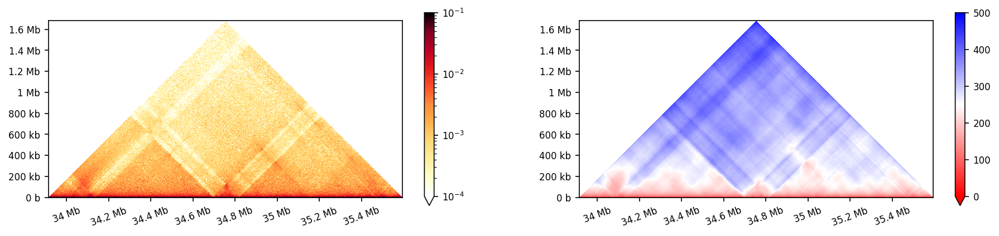

fbn2


100%|██████████| 1600/1600 [00:13<00:00, 119.46it/s]


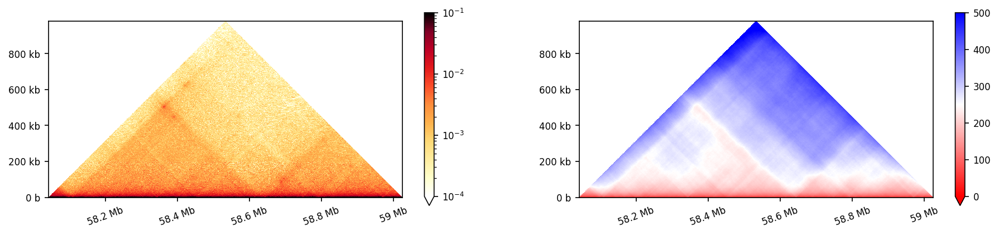

In [27]:
from tqdm import tqdm
for name in domains:
    print(name)
    region = prod[name]['mei'].mei.config['region']
    chrom, start, end = parse_region(region)
    ref_map = prod[name]['mei'].get_reference_contact_map()

    w = 250
    vmin = 1e-4
    vmax = 1e-1
    
    f, ax = plt.subplots(1, 2, figsize=(15, 3))
    factor = 5
    contact_map = ContactMap(coarse_grain_map(ref_map, factor=factor), chrom=chrom, start=start, end=end, resolution=200*factor)
    contact_map.plot_contact_map_horizontal(vmin=vmin, vmax=vmax, ax=ax[0])

    factor = 10
    dists = []
    for d in tqdm(domains[name]):
        positions = np.vstack([d.positions[i:i+factor].mean(axis=0) for i in range(0, len(d.positions), factor)])
        dists += [get_distance_matrix(positions)]
    dists = np.median(dists, axis=0)
    dists = ContactMap(dists, chrom=chrom, start=start, end=end, resolution=200*factor)
    dists.plot_contact_map_horizontal(vmin=0, vmax=500, cmap='bwr_r', log_norm=False, ax=ax[1])
    plt.savefig(f'img/stochastic_average_{name}.pdf')
    plt.show()

# Domain sizes

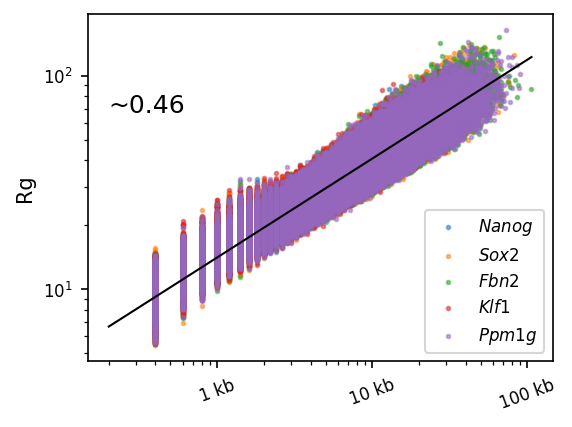

In [28]:
sizes = {}
for name in main_names:
    sizes[name] = []
    for domain in domains_ins[name]:
        for cluster in range(domain.n_clusters):
            points = domain.positions[domain.labels == cluster]
            sizes[name] += [200*len(points)]
    sizes[name] = np.array(sizes[name])

rgs = {}
for name in main_names:
    rgs[name] = []
    for domain in domains_ins[name]:
        for cluster in range(domain.n_clusters):
            points = domain.positions[domain.labels == cluster]
            rgs[name] += [np.sqrt(np.sum((points - points.mean(axis=0, keepdims=True))**2) / len(points))]
    rgs[name] = np.array(rgs[name])

f, ax = plt.subplots(figsize=(4, 3))
for name in main_names:
    ax.scatter(sizes[name], rgs[name], s=3, label=stylized_names[name], alpha=0.5, rasterized=True)

all_rgs = np.concatenate([rgs[name] for name in main_names])
all_sizes = np.concatenate([sizes[name] for name in main_names])
popt, _ = curve_fit(power_law, all_sizes, all_rgs)
x = np.linspace(200, np.max(all_sizes))
ax.plot(x, power_law(x, *popt),  color='black', lw=1)
ax.text(x[0], power_law(x[len(x)//4], *popt), f'~{popt[1]:.2f}', color='black', fontsize=12, ha='left', va='bottom')

ax.set_yscale('log')
ax.set_xscale('log') 
ax.set_ylabel('Rg')
ax.legend()
format_ticks(ax, y=False)
plt.savefig('img/insulated_domain_sizes_vs_rg.pdf')
plt.show()

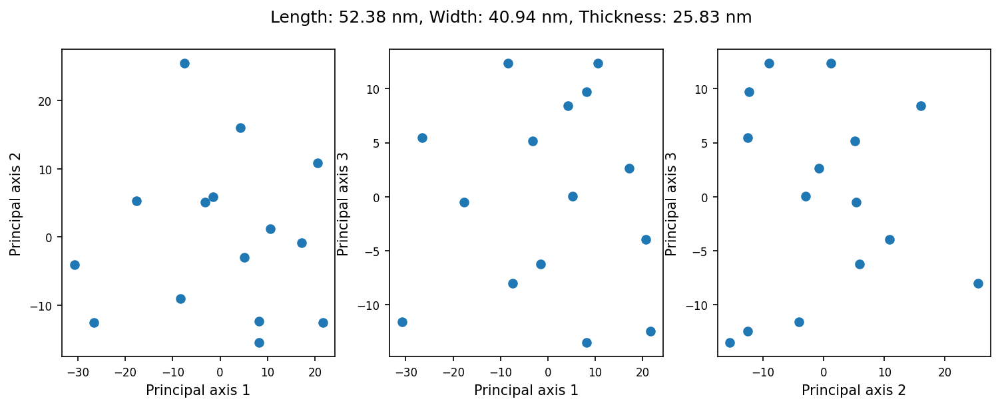

nanog
Number of domains: 18709
Average size: 144.88 ± 295.46 nucleosomes
Length: 130.34 ± 103.75 nm
Width: 94.01 ± 74.14 nm
Thickness: 71.19 ± 58.29 nm
Aspect ratio (length/width): 1.40 ± 0.28
klf1
Number of domains: 30116
Average size: 225.85 ± 635.87 nucleosomes
Length: 135.93 ± 136.33 nm
Width: 98.76 ± 98.29 nm
Thickness: 75.06 ± 77.35 nm
Aspect ratio (length/width): 1.39 ± 0.28
ppm1g
Number of domains: 13307
Average size: 616.92 ± 1505.55 nucleosomes
Length: 169.71 ± 197.48 nm
Width: 124.65 ± 147.74 nm
Thickness: 96.82 ± 120.61 nm
Aspect ratio (length/width): 1.40 ± 0.29
sox2
Number of domains: 15256
Average size: 831.63 ± 2287.13 nucleosomes
Length: 164.38 ± 220.28 nm
Width: 122.87 ± 169.70 nm
Thickness: 96.33 ± 141.29 nm
Aspect ratio (length/width): 1.39 ± 0.28
fbn2
Number of domains: 17179
Average size: 419.34 ± 1084.58 nucleosomes
Length: 160.15 ± 176.61 nm
Width: 116.23 ± 131.30 nm
Thickness: 88.62 ± 104.12 nm
Aspect ratio (length/width): 1.42 ± 0.29
Overall average size: 397.

Number of domains: 155685
Average size: 42.48 ± 34.23 nucleosomes
Length: 104.12 ± 47.19 nm
Width: 65.62 ± 27.55 nm
Thickness: 46.84 ± 20.15 nm
Aspect ratio (length/width): 1.62 ± 0.42
Overall average size: 36.07 ± 29.14 nucleosomes
Overall Length: 95.55 ± 42.00 nm
Overall Width: 60.82 ± 24.76 nm
Overall Thickness: 43.24 ± 18.35 nm
Overall Aspect ratio (length/width): 1.60 ± 0.41


In [29]:
def length_width(points, plot=False):
    # points: (N, 3) array
    centered = points - points.mean(axis=0)
    cov = np.cov(centered, rowvar=False)
    eigvals, eigvecs = np.linalg.eigh(cov)
    # Sort eigenvectors by eigenvalues (descending)
    order = np.argsort(eigvals)[::-1]
    eigvecs = eigvecs[:, order]
    # Project points onto principal axes
    proj = centered @ eigvecs
    length = proj[:, 0].max() - proj[:, 0].min()
    width = proj[:, 1].max() - proj[:, 1].min()
    thickness = proj[:, 2].max() - proj[:, 2].min()

    if plot:
        f, ax = plt.subplots(1, 3, figsize=(12, 4))
        ax[0].scatter(proj[:, 0], proj[:, 1])
        ax[0].set_xlabel('Principal axis 1')
        ax[0].set_ylabel('Principal axis 2')
        ax[1].scatter(proj[:, 0], proj[:, 2])
        ax[1].set_xlabel('Principal axis 1')
        ax[1].set_ylabel('Principal axis 3')
        ax[2].scatter(proj[:, 1], proj[:, 2])
        ax[2].set_xlabel('Principal axis 2')
        ax[2].set_ylabel('Principal axis 3')
        f.suptitle(f'Length: {length:.2f} nm, Width: {width:.2f} nm, Thickness: {thickness:.2f} nm')
        plt.show()

    return length, width, thickness

def characterize_shapes(domains):
    all_lengths, all_widths, all_thicknesses, all_sizes = [], [], [], []
    for name, _domains in domains.items():
        print(name)
        lengths, widths, thicknesses, sizes = [], [], [], []
        for domain in _domains:
            for i in range(np.max(domain.labels)):
                positions = domain.positions[domain.labels == i]
                if len(positions) < 10:
                    continue
                length, width, thickness = length_width(positions)
                lengths.append(length)
                widths.append(width)
                thicknesses.append(thickness)
                sizes.append(len(positions))
        lengths = np.array(lengths)
        widths = np.array(widths)
        thicknesses = np.array(thicknesses)
        sizes = np.array(sizes)
        print(f'Number of domains: {len(lengths)}')
        print(f'Average size: {np.mean(sizes):.2f} ± {np.std(sizes):.2f} nucleosomes')
        print(f'Length: {np.mean(lengths):.2f} ± {np.std(lengths):.2f} nm')
        print(f'Width: {np.mean(widths):.2f} ± {np.std(widths):.2f} nm')
        print(f'Thickness: {np.mean(thicknesses):.2f} ± {np.std(thicknesses):.2f} nm')
        print(f'Aspect ratio (length/width): {np.mean(lengths / widths):.2f} ± {np.std(lengths / widths):.2f}')

        all_lengths.append(lengths)
        all_widths.append(widths)
        all_thicknesses.append(thicknesses)
        all_sizes.append(sizes)
    all_lengths = np.concatenate(all_lengths)
    all_widths = np.concatenate(all_widths)
    all_thicknesses = np.concatenate(all_thicknesses)
    all_sizes = np.concatenate(all_sizes)
    print(f'Overall average size: {np.mean(all_sizes):.2f} ± {np.std(all_sizes):.2f} nucleosomes')
    print(f'Overall Length: {np.mean(all_lengths):.2f} ± {np.std(all_lengths):.2f} nm')
    print(f'Overall Width: {np.mean(all_widths):.2f} ± {np.std(all_widths):.2f} nm')
    print(f'Overall Thickness: {np.mean(all_thicknesses):.2f} ± {np.std(all_thicknesses):.2f} nm')
    print(f'Overall Aspect ratio (length/width): {np.mean(all_lengths / all_widths):.2f} ± {np.std(all_lengths / all_widths):.2f}')
    return all_lengths, all_widths, all_thicknesses, all_sizes

points = domains_ins['fbn2'][0].positions[domains_ins['fbn2'][0].labels == 10]
length, width, thickness = length_width(points, plot=True)

characterize_shapes({k:v for k, v in domains.items() if k in main_names})
characterize_shapes({k:v for k, v in domains_ins.items() if k in main_names});

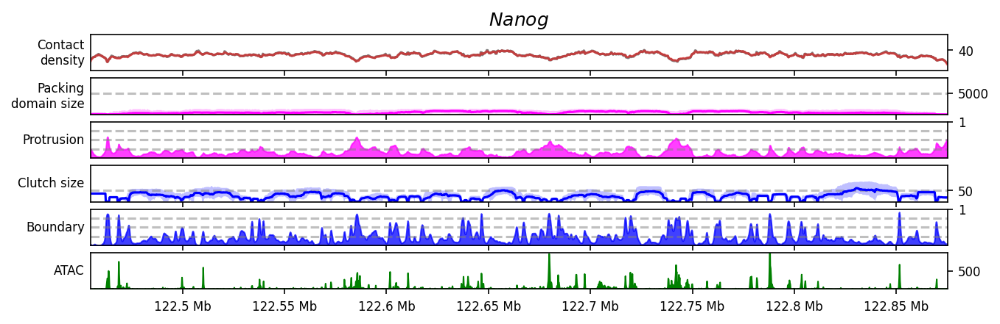

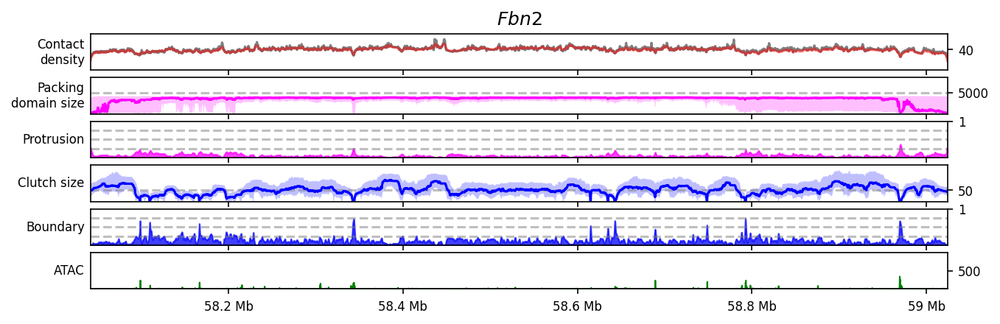

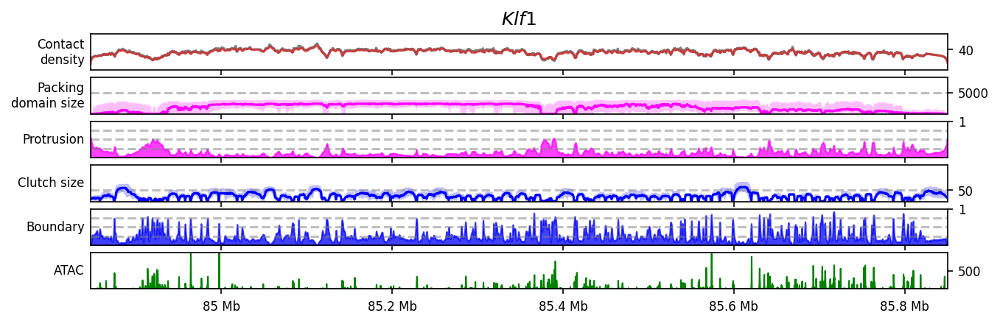

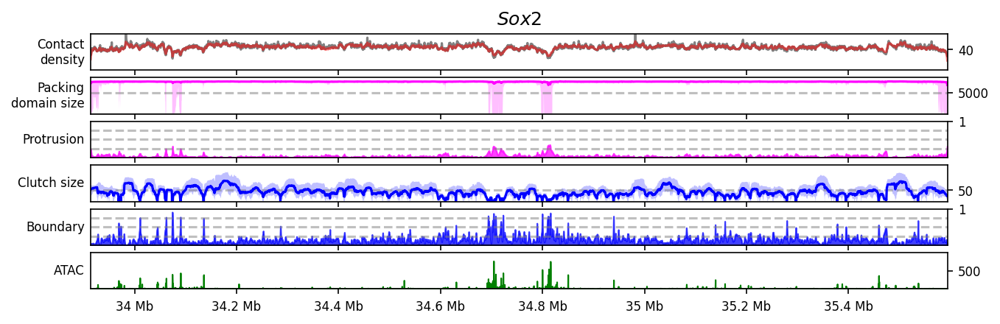

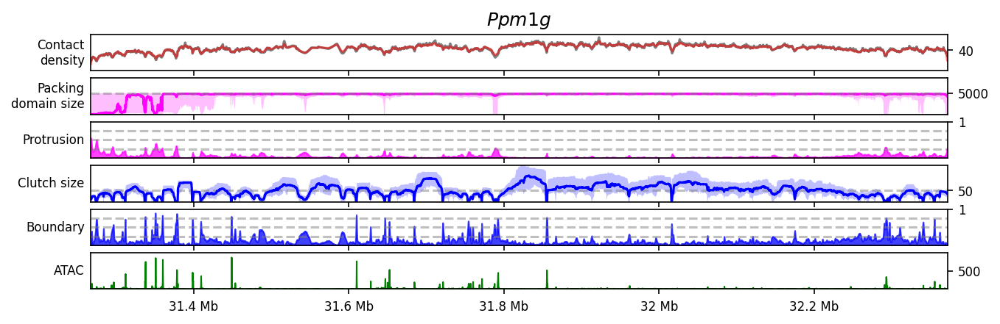

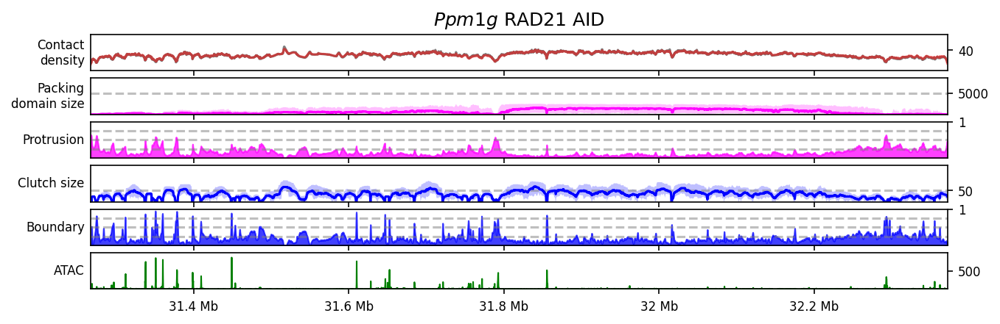

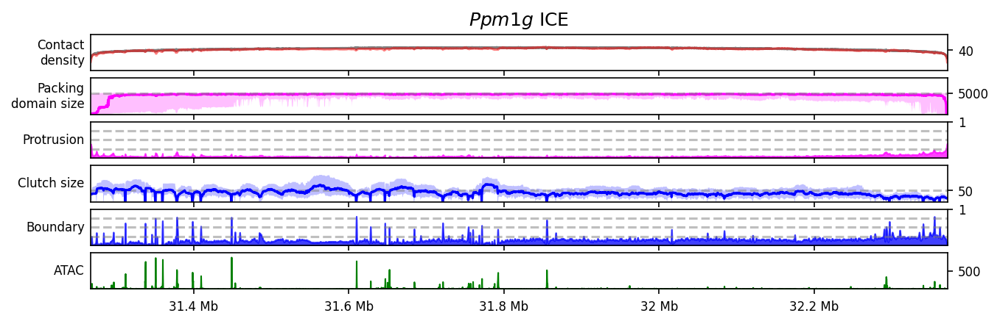

In [30]:
from neighbor_balance.ice import get_marginal

def get_sizes(labels):
    sizes = np.ones(labels.shape)
    for t, label in enumerate(labels):
        for i in np.unique(labels):
            if i < 0:
                continue
            mask = label == i
            sizes[t, mask] = np.sum(mask)
    return sizes

def add_grid(ax):
    for y in [0.25, 0.5, 0.75]:
        ax.axhline(y, c='gray', ls='--', alpha=0.5)

def plot_all_traces(name, show_sizes=True, width=10, height=3):
    region = prod[name]['mei'].mei.config['region']
    chrom, start, end = parse_region(region)
    ref_map = prod[name]['mei'].get_reference_contact_map()
    sim_map = prod[name]['mei'].get_precomputed_contact_map(prod[name]['iteration'])

    packing = np.array([d.labels for d in domains[name]])
    sections = np.array([d.labels for d in domains_ins[name]])

    atac = f'{omics}/genomics_data/GSE98390_E14_ATAC_MERGED.DANPOS.mm39.bw'
    atac = load_bw(atac, chrom, start, end)
    atac = bin_track(atac, step=200)

    f, ax = plt.subplots(6 if show_sizes else 4, figsize=(width, height), sharex=True)
    
    # Contact density
    i = 0
    ax[i].plot(np.arange(start, end, 200), 2*get_marginal(ref_map), c='gray')
    ax[i].plot(np.arange(start, end, 200), 2*get_marginal(sim_map), c='red', alpha=0.5)
    ax[i].set_ylim(0, 70)
    ax[i].yaxis.tick_right()
    ax[i].set_ylabel('Contact\ndensity', rotation=0, ha='right', va='center', size=8)
    ax[i].set_yticks([40])

    # Packing domain sizes
    if show_sizes:
        i += 1
        sizes = get_sizes(packing[::10])
        low = np.percentile(sizes, 25, axis=0)
        mid = np.percentile(sizes, 50, axis=0)
        high = np.percentile(sizes, 75, axis=0)
        ax[i].axhline(50, c='gray')
        ax[i].fill_between(np.arange(start, end, 200), low, high, facecolor='magenta', alpha=0.25)
        ax[i].plot(np.arange(start, end, 200), mid, c='magenta')
        ax[i].set_ylim(0, 8500)
        ax[i].set_yticks([5000])
        ax[i].axhline(5000, c='gray', ls='--', alpha=0.5)
        ax[i].set_ylabel('Packing\ndomain size', rotation=0, ha='right', va='center', size=8)

    # Protrusion
    i += 1
    p_loop = np.mean([d.labels == -1 for d in domains[name]], axis=0)
    ax[i].fill_between(np.arange(start, end, 200), 0, p_loop, color='magenta', alpha=0.75)
    ax[i].set_ylim(0, 1)
    ax[i].yaxis.tick_right()
    ax[i].set_ylabel('Protrusion', rotation=0, ha='right', va='center', size=8)
    ax[i].set_yticks([1])
    add_grid(ax[i])

    # Insulation domain sizes
    if show_sizes:
        i += 1
        sizes = get_sizes(sections[::10])
        low = np.percentile(sizes, 25, axis=0)
        mid = np.percentile(sizes, 50, axis=0)
        high = np.percentile(sizes, 75, axis=0)
        ax[i].axhline(50, c='gray', ls='--', alpha=0.5)
        ax[i].fill_between(np.arange(start, end, 200), low, high, facecolor='blue', alpha=0.25)
        ax[i].plot(np.arange(start, end, 200), mid, c='blue')
        ax[i].set_ylim(0, 160)
        ax[i].set_yticks([50])
        ax[i].set_ylabel('Clutch size', rotation=0, ha='right', va='center', size=8)
    
    # Boundaries
    i += 1
    ax[i].fill_between(np.arange(start, end, 200), 0, np.mean(sections==-1, axis=0), alpha=0.75, color='blue')
    ax[i].set_ylim(0, 1)
    ax[i].set_yticks([1])
    ax[i].set_ylabel('Boundary', rotation=0, ha='right', va='center', size=8)
    add_grid(ax[i])

    # ATAC
    i += 1
    ax[i].fill_between(np.arange(start, end, 200), 0, atac, color='green')
    ax[i].set_ylim(0, 1000)
    ax[i].set_yticks([500])
    ax[i].set_ylabel('ATAC', rotation=0, ha='right', va='center', size=8)

    for a in ax:
        a.yaxis.tick_right()

    ax[-1].set_xlim(start, end)
    format_ticks(ax[-1], y=False, rotate=False)
    ax[0].set_title(stylized_names[name])
    return ax

for name in ['nanog', 'fbn2', 'klf1', 'sox2', 'ppm1g', 'ppm1g_rad21_aid', 'ppm1g_ice']:
    ax = plot_all_traces(name)
    plt.savefig(f'img/insulation_domains_sizes_{name}.pdf')
    plt.show()

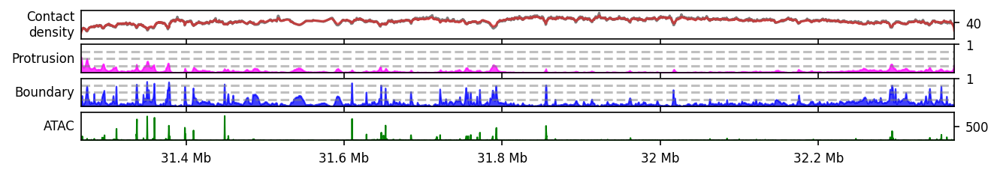

In [31]:
ax = plot_all_traces('ppm1g', show_sizes=False, height=1.5)
ax[0].set_title(None)
plt.savefig(f'img/insulation_domains_ppm1g.pdf')
plt.show()

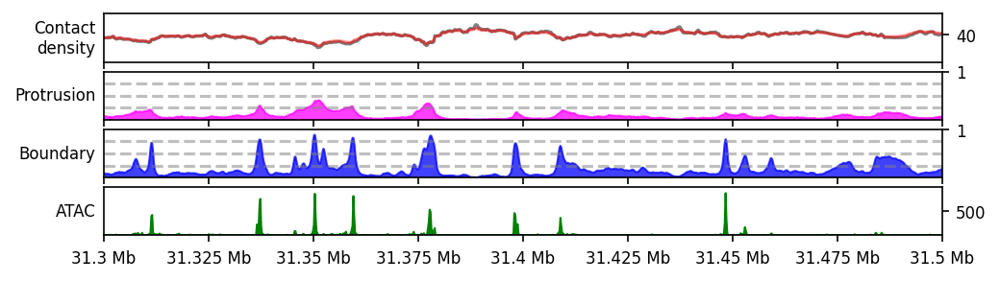

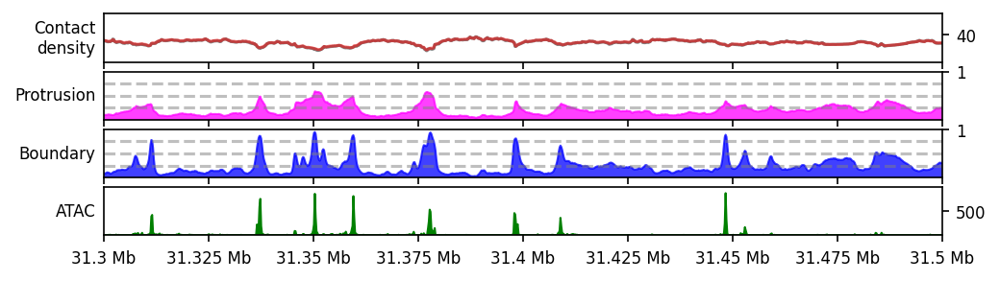

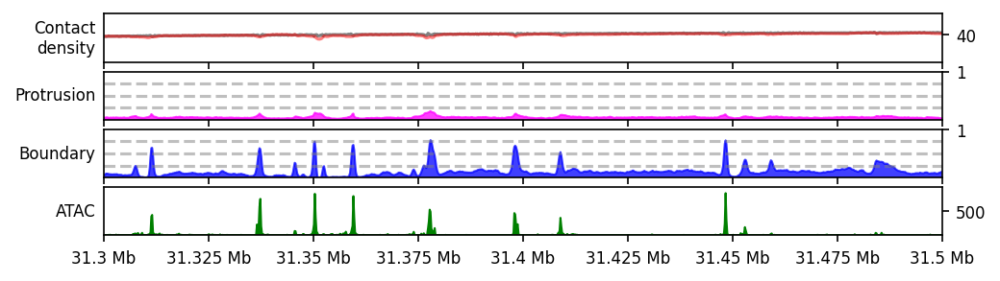

In [32]:
for name in ['ppm1g', 'ppm1g_rad21_aid', 'ppm1g_ice']:
    ax = plot_all_traces(name, show_sizes=False, width=7.5, height=2)
    ax[-1].set_xlim(31_300_000, 31_500_000)
    ax[0].set_title(None)
    plt.savefig(f'img/insulation_domains_sizes_zoom_{name}.pdf')
    plt.show()

In [ ]:
from scipy.stats import gaussian_kde

def myhist(data, bins, ax=None, density=True, bw = 0.05, alpha=1, lw=1, n_points=1000, weights=None, **kwargs):
    p = plt if ax is None else ax
    if data.min() < bins[0] or data.max() > bins[-1]:
        print(f'Warning: data outside range ({data.min()} to {data.max()} vs {bins[0]} to {bins[-1]})')
    
    cov = np.cov(np.log10(data), aweights=weights if weights is not None else None)
    kde = gaussian_kde(np.log10(data), weights=weights, bw_method=bw / cov**0.5)

    x = np.arange(1, 500) * 200 # plot every 200 bp from 200 to 100 kb
    x = np.concatenate([x, np.logspace(np.log10(x[-1]), np.log10(bins[-1]), n_points)])
    y = kde(np.log10(x))
    p.plot(x, y, lw=lw, alpha=alpha, **kwargs)

nanog 28800
nanog 385600


klf1 41200
klf1 898200
ppm1g 30600
ppm1g 1079800
sox2 23600
sox2 1637400
fbn2 22400
fbn2 947800


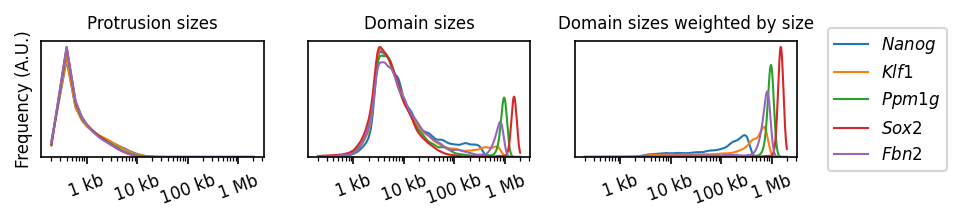

ppm1g 30600
ppm1g 1079800
ppm1g_rad21_aid 47400
ppm1g_rad21_aid 949200


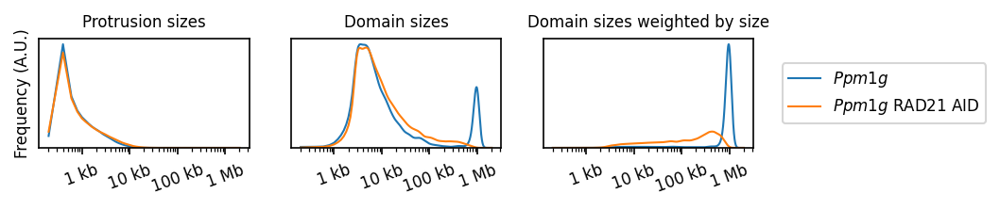

In [30]:
for name_filter, plot_fname in [(lambda x: name in main_names, 'img/domain_sizes.pdf'),
                                (lambda x: name in ['ppm1g', 'ppm1g_rad21_aid'], 'img/domain_sizes_rad21.pdf')]:
    bins = np.logspace(np.log10(199), np.log10(2_000_000), 21)
    f, axs = plt.subplots(1, 3, sharex=True, figsize=(6.5, 1))
    for name, domain in domains.items():
        if not name_filter(name):
            continue

        # Linkers.
        linkers = [Domains(d.positions.copy(), get_segments(d.labels == -1)) for d in domain]
        w = np.array([np.sum(_domain.labels==i) for _domain in linkers for i in range(_domain.n_clusters)])
        w *= 200
        print(name, np.max(w))
        myhist(w, bins=bins, label=stylized_names[name], ax=axs[0], weights=np.zeros(w.shape) + 1 / len(w), density=False)

        # Domains
        w = np.array([np.sum(_domain.labels==i) for _domain in domain for i in range(_domain.n_clusters)])
        w *= 200
        print(name, np.max(w))
        myhist(w, bins=bins, label=stylized_names[name], ax=axs[1], weights=np.zeros(w.shape) + 1 / len(w), density=False)
        myhist(w, bins=bins, label=stylized_names[name], ax=axs[2], weights=w/sum(w), density=False)

    axs[0].set_title('Protrusion sizes', fontsize=8)
    axs[1].set_title('Domain sizes', fontsize=8)
    axs[2].set_title('Domain sizes weighted by size', fontsize=8)
    axs[0].set_ylabel('Frequency (A.U.)', fontsize=8)
    axs[1].set_xscale('log')

    axs[2].legend(fontsize=8, loc='center left', bbox_to_anchor=(1.1, 0.5))
    for ax in axs:
        ax.set_yticks([])
        ax.set_ylim(0, None)
        format_ticks(ax, y=False)
    plt.savefig(plot_fname)
    plt.show()

[1.99000000e+02 2.92153066e+02 4.28911627e+02 6.29687673e+02
 9.24448161e+02 1.35718776e+03 1.99249530e+03 2.92519403e+03
 4.29449449e+03 6.30477251e+03 9.25607346e+03 1.35888957e+04
 1.99499373e+04 2.92886199e+04 4.29987944e+04 6.31267820e+04
 9.26767985e+04 1.36059351e+05 1.99749530e+05 2.93253455e+05
 4.30527115e+05 6.32059380e+05 9.27930078e+05 1.36229958e+06
 2.00000000e+06]
nanog 28800


klf1 41200
ppm1g 30600
sox2 23600
fbn2 22400


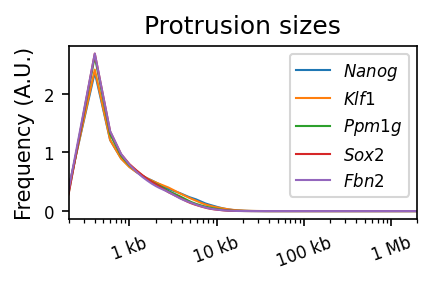

nanog 47400
klf1 59400
ppm1g 90200
sox2 82000
fbn2 106200


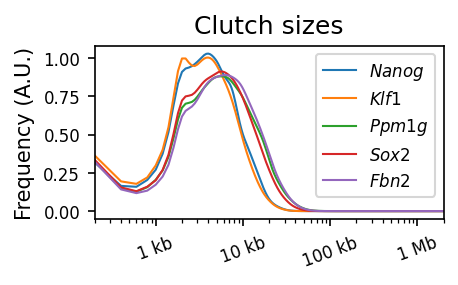

nanog 385600
klf1 898200
ppm1g 1079800
sox2 1637400
fbn2 947800


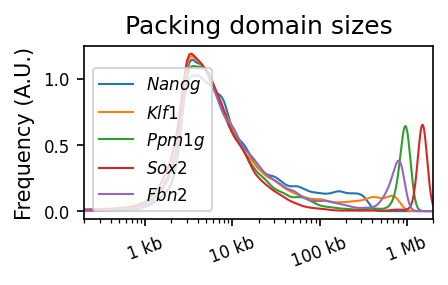

nanog 385600
klf1 898200
ppm1g 1079800
sox2 1637400
fbn2 947800


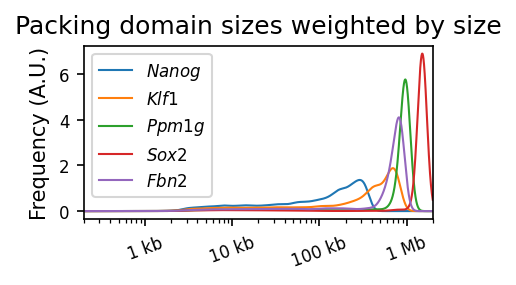

ppm1g 30600
ppm1g_rad21_aid 47400


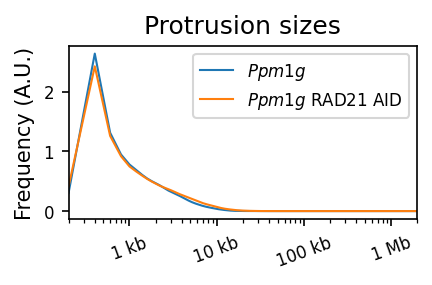

ppm1g 90200
ppm1g_rad21_aid 73400


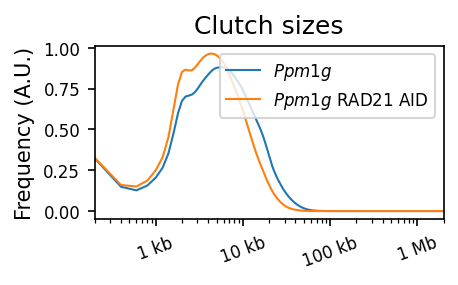

ppm1g 1079800
ppm1g_rad21_aid 949200


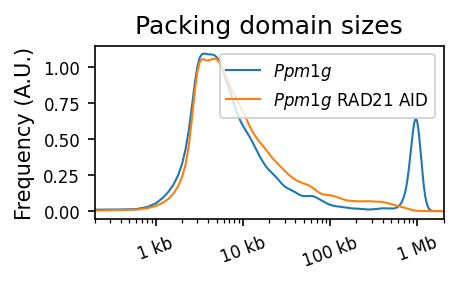

ppm1g 1079800
ppm1g_rad21_aid 949200


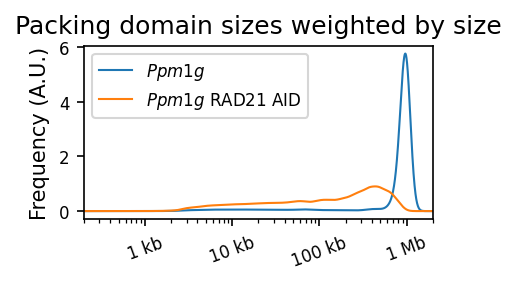

In [35]:
def plot_linkers(domains, ax, bins, name, **kwargs):
    linkers = [Domains(d.positions.copy(), get_segments(d.labels == -1)) for d in domain]
    w = np.array([np.sum(_domain.labels==i) for _domain in linkers for i in range(_domain.n_clusters)])
    w *= 200
    print(name, np.max(w))
    myhist(w, bins=bins, label=stylized_names[name], ax=ax, weights=np.zeros(w.shape) + 1 / len(w), density=False, **kwargs)

def plot_packing_domains(domains, ax, bins, name, weighted=False, **kwargs):
    # Domains
    w = np.array([np.sum(_domain.labels==i) for _domain in domain for i in range(_domain.n_clusters)])
    w *= 200
    print(name, np.max(w))
    if weighted:
        myhist(w, bins=bins, label=stylized_names[name], ax=ax, weights=w/sum(w), density=False, **kwargs)
    else:
        myhist(w, bins=bins, label=stylized_names[name], ax=ax, weights=np.zeros(w.shape) + 1 / len(w), density=False, **kwargs)

def plot_insulated_domains(domains, ax, bins, name, **kwargs):
    insulation = insulations[name]
    mask = insulation[10] > median_insulation[10] - 1.0
    domain = [Domains(np.zeros((mask.shape[1], 3)), get_segments(m)) for m in mask]

    w = np.array([np.sum(_domain.labels==i) for _domain in domain for i in range(_domain.n_clusters)])
    w *= 200
    print(name, np.max(w))
    myhist(w, bins=bins, label=stylized_names[name], ax=ax, weights=np.zeros(w.shape) + 1 / len(w), density=False, **kwargs)


bins = np.logspace(np.log10(199), np.log10(2_000_000), 25)
print(bins)

for name_filter, group_name in [(lambda x: name in main_names, 'main'),
                                (lambda x: name in ['ppm1g', 'ppm1g_rad21_aid'], 'rad21')]:
    
    plot_fname = f'img/domain_sizes_{group_name}_{{}}.pdf'
                            
    f, ax = plt.subplots(1, sharex=True, figsize=(3, 1.5))
    for name, domain in domains.items():
        if not name_filter(name): continue
        plot_linkers(domain, ax, bins, name)
    ax.set_title('Protrusion sizes')
    ax.set_ylabel('Frequency (A.U.)')
    ax.set_xscale('log')
    ax.legend()
    ax.set_xlim(200, 2_000_000)
    format_ticks(ax, y=False)
    plt.savefig(plot_fname.format('protrusions'))
    plt.show()

    f, ax = plt.subplots(1, sharex=True, figsize=(3, 1.5))
    for name, domain in domains.items():
        if not name_filter(name): continue
        plot_insulated_domains(domain, ax, bins, name)
    ax.set_title('Clutch sizes')
    ax.set_ylabel('Frequency (A.U.)')
    ax.set_xscale('log')
    ax.legend()
    ax.set_xlim(200, 2_000_000)
    format_ticks(ax, y=False)
    plt.savefig(plot_fname.format('insulated'))
    plt.show()

    f, ax = plt.subplots(1, sharex=True, figsize=(3, 1.5))
    for name, domain in domains.items():
        if not name_filter(name): continue
        plot_packing_domains(domain, ax, bins, name)
    ax.set_title('Packing domain sizes')
    ax.set_ylabel('Frequency (A.U.)')
    ax.set_xscale('log')
    ax.legend()
    ax.set_xlim(200, 2_000_000)
    format_ticks(ax, y=False)
    plt.savefig(plot_fname.format('packing'))
    plt.show()

    f, ax = plt.subplots(1, sharex=True, figsize=(3, 1.5))
    for name, domain in domains.items():
        if not name_filter(name): continue
        plot_packing_domains(domain, ax, bins, name, weighted=True)
    ax.set_title('Packing domain sizes weighted by size')
    ax.set_ylabel('Frequency (A.U.)')
    ax.set_xscale('log')
    ax.legend()
    ax.set_xlim(200, 2_000_000)
    format_ticks(ax, y=False)
    plt.savefig(plot_fname.format('packing_weighted'))
    plt.show()

packing domains 947800
nanog 47400
klf1 59400
ppm1g 90200
sox2 82000
fbn2 106200


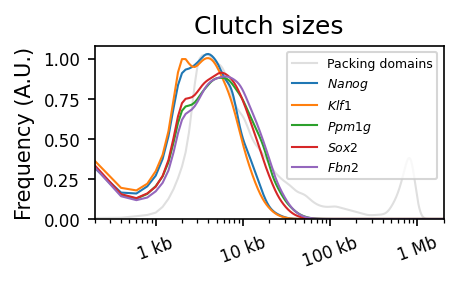

In [32]:
f, ax = plt.subplots(1, sharex=True, figsize=(3, 1.5))

all_domains = []
for name, domain in domains.items():
    if name in main_names:
        all_domains += domain
plot_packing_domains(all_domains, ax, bins, 'packing domains', color='gray', alpha=0.25)

for name, domain in domains.items():
    if name not in main_names: continue
    plot_insulated_domains(domain, ax, bins, name)
ax.set_title('Clutch sizes')
ax.set_ylabel('Frequency (A.U.)')
ax.set_xscale('log')
ax.legend(fontsize=6)
ax.set_xlim(200, 2_000_000)
ax.set_ylim(0, None)
format_ticks(ax, y=False)
plt.savefig('img/insulated_domain_sizes.pdf')
plt.show()

/tmp/ipykernel_603261/1025127994.py:8: RuntimeWarning: divide by zero encountered in log10
  cov = np.cov(np.log10(data), aweights=weights if weights is not None else None)
/tmp/ipykernel_603261/1025127994.py:8: RuntimeWarning: invalid value encountered in log10
  cov = np.cov(np.log10(data), aweights=weights if weights is not None else None)
/tmp/ipykernel_603261/1025127994.py:9: RuntimeWarning: divide by zero encountered in log10
  kde = gaussian_kde(np.log10(data), weights=weights, bw_method=bw / cov**0.5)
/tmp/ipykernel_603261/1025127994.py:9: RuntimeWarning: invalid value encountered in log10
  kde = gaussian_kde(np.log10(data), weights=weights, bw_method=bw / cov**0.5)


ValueError: array must not contain infs or NaNs

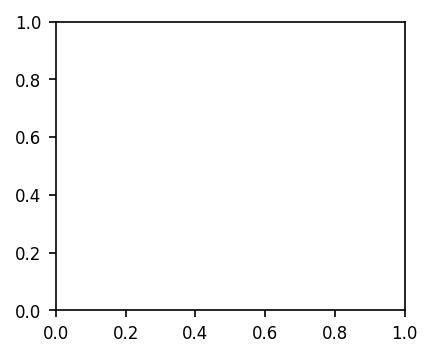

In [33]:
bins = np.linspace(-8, 1, 21)

for name_filter, plot_fname in [(lambda x: name in main_names, 'img/insulation_scores.pdf'),
                                (lambda x: name in ['ppm1g', 'ppm1g_rad21_aid'], 'img/insulation_scores_rad21.pdf')]:
    f, ax = plt.subplots(1, sharex=True, figsize=(3, 2.5))

    for name, domain in domains.items():
        if not name_filter(name): continue
        insulation = insulations[name][10].flatten()
        myhist(insulation, bins=bins, label=stylized_names[name], ax=ax, weights=np.zeros(insulation.shape) + 1 / len(insulation), density=False)

    ax.set_title('Insulation scores')
    ax.set_ylabel('Frequency (A.U.)')
    ax.legend()
    plt.savefig(plot_fname)
    plt.show()

# Statistical analysis

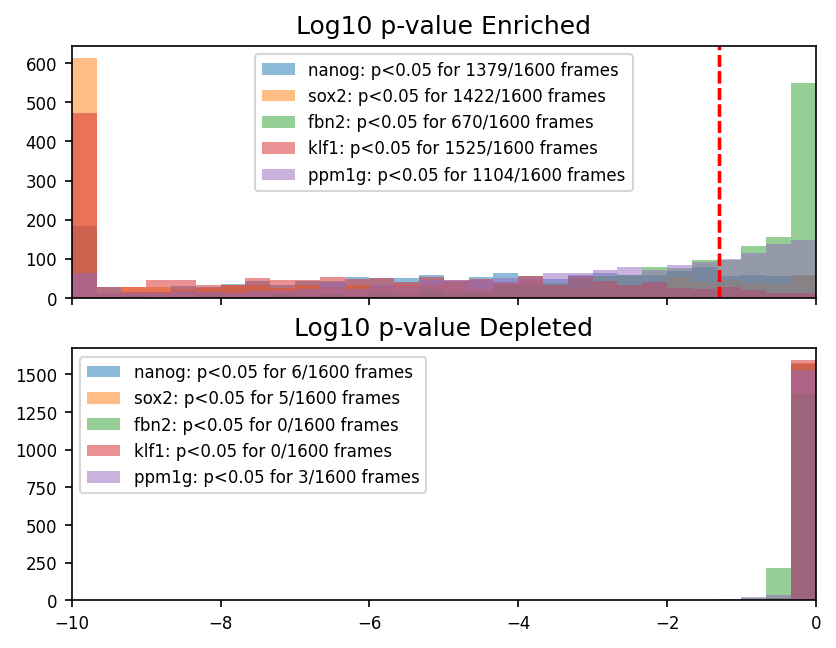

In [8]:
from scipy.stats import fisher_exact

f, ax = plt.subplots(2, sharex=True)
for name in main_names:
    region = prod[name]['mei'].mei.config['region']
    chrom, start, end = parse_region(region)

    x = np.arange(start, end, 200)
    atac = f'{omics}/genomics_data/GSE98390_E14_ATAC_MERGED.DANPOS.mm39.bw'
    atac = load_bw(atac, chrom, start, end)
    atac = bin_track(atac, step=200)
    res = atac > 100

    buff = 100_000 // 200
    metrics = {}
    res = res[buff:-buff]

    p_less = []
    p_greater = []
    merged_table = np.array([[0, 0], [0, 0]])
    for d in domains[name]:
        protrusions = d.labels == -1
        protrusions = protrusions[buff:-buff]

        tp = np.sum(protrusions & res)
        tn = np.sum(~protrusions & ~res)
        fp = np.sum(protrusions & ~res)
        fn = np.sum(~protrusions & res)
        table = np.array([[tp, fp], [fn, tn]])
        merged_table += table
        p_less += [fisher_exact(table, alternative='less')[1]]
        p_greater += [fisher_exact(table, alternative='greater')[1]]
    p_less = np.array(p_less)
    p_greater = np.array(p_greater)
    p_less[p_less < 10**-10] = 10**-10
    p_greater[p_greater < 10**-10] = 10**-10
    bins = np.linspace(-10, 0, 10*3 + 1)
    
    ax[0].hist(np.log10(p_greater), alpha=0.5, bins=bins, label=f'{name}: p<0.05 for {np.sum(p_greater < 0.05)}/{len(p_greater)} frames')
    ax[1].hist(np.log10(p_less), alpha=0.5, bins=bins, label=f'{name}: p<0.05 for {np.sum(p_less < 0.05)}/{len(p_less)} frames')
    ax[0].set_title('Log10 p-value Enriched')
    ax[1].set_title('Log10 p-value Depleted')
    ax[0].axvline(np.log10(0.05), color='red', linestyle='--')
    ax[0].legend()
    ax[1].legend()
    ax[0].set_xlim(bins[0], bins[-1])
    #print(name, np.sum(p < 0.05), '/', len(p), fisher_exact(merged_table))
plt.show()

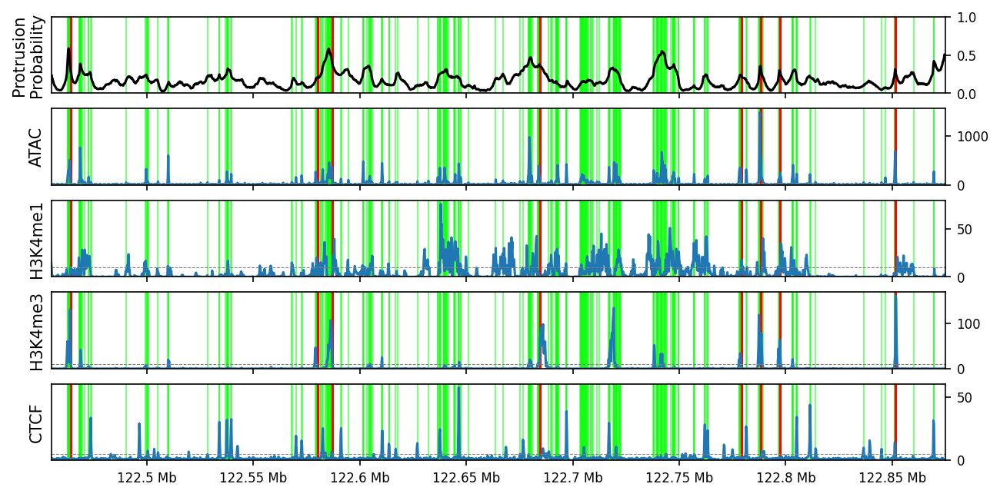

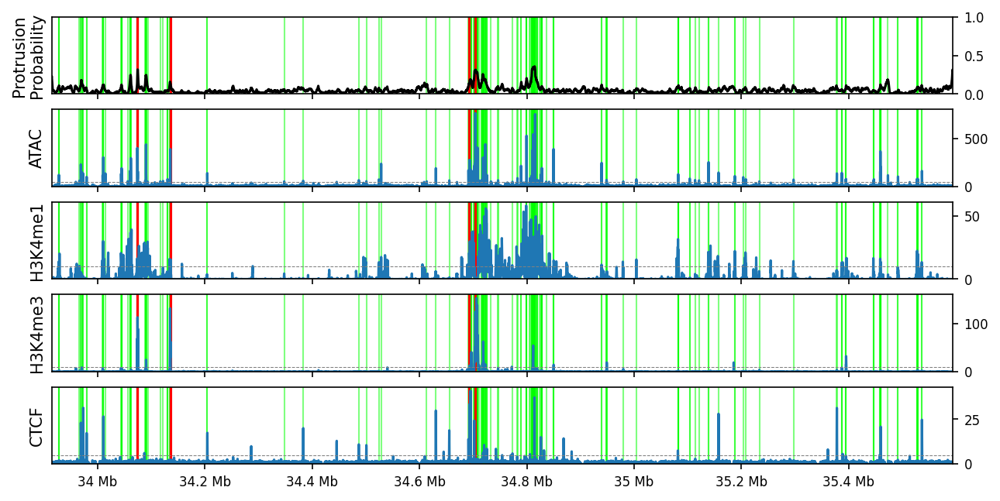

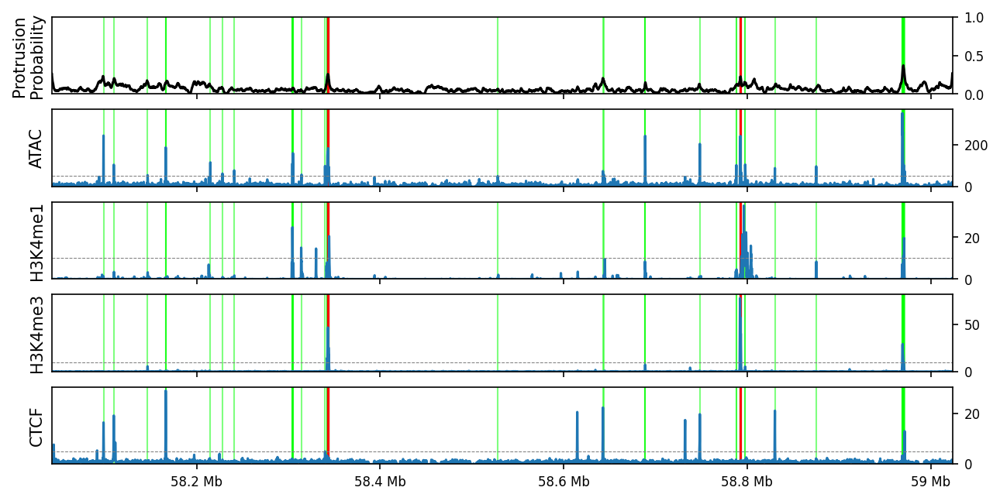

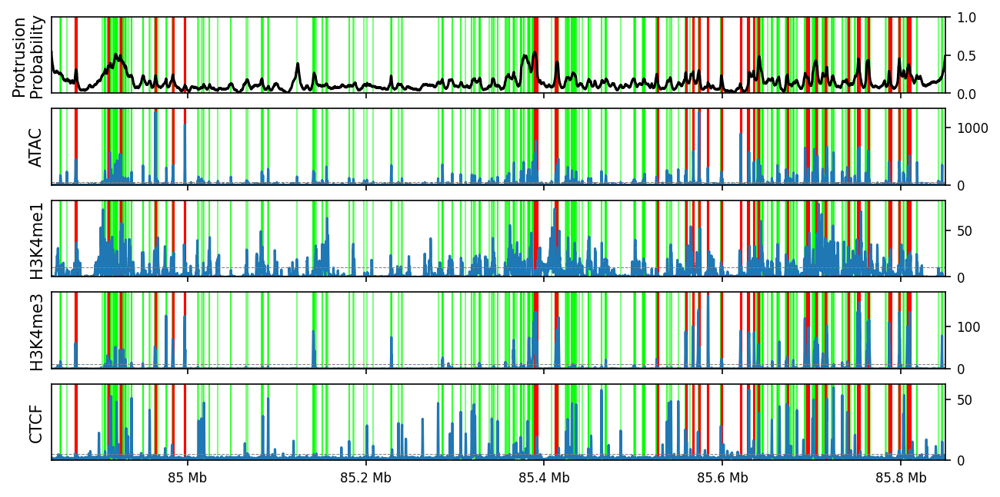

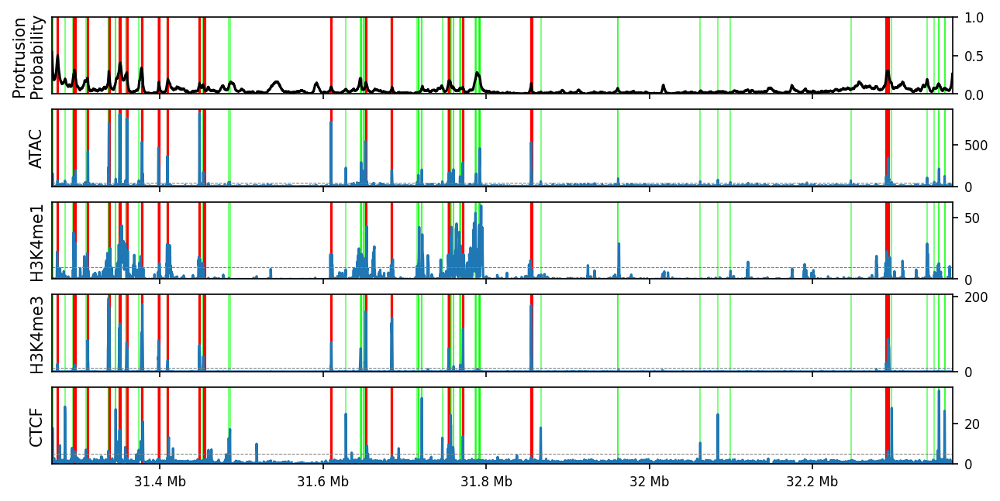

In [15]:
from neighbor_balance import gtf
from scipy.signal import find_peaks

def load_annotations(annotations, alias):
    annotations = gtf.dataframe(annotations)
    alias = pd.read_csv(alias, sep='\t')
    alias.rename(columns={'# ucsc': 'ucsc'}, inplace=True)
    annotations['chrom'] = annotations['seqname'].apply(lambda x: alias.loc[alias['refseq'] == x, 'ucsc'].values[0])
    annotations['start'] = annotations['start'].astype(int)
    annotations['end'] = annotations['end'].astype(int)
    return annotations

class RegulatoryElementAnnotator:
    def __init__(self, tracks, thresholds=None, resolution=200, annotations='/home/joepaggi/share/ucsc/mm39_gene.gtf', alias='/home/joepaggi/share/ucsc/mm39.chromAlias.txt'):
        self.annotations = load_annotations(annotations=annotations, alias=alias)
        self.tracks = tracks
        self.thresholds = thresholds
        self.resolution = resolution

        required_tracks = ['CTCF', 'ATAC', 'H3K4me1', 'H3K4me3']
        for required_track in required_tracks:
            assert required_track in self.tracks, required_track

    def get_genes(self, chrom, start, end):
        annotations = self.annotations.loc[self.annotations.chrom == chrom]
        starts_in_region = (annotations.start >= start) & (annotations.start <= end)
        ends_in_region = (annotations.end >= start) & (annotations.end <= end)
        annotations = annotations.loc[starts_in_region | ends_in_region]
        return annotations

    def get_epigenetics(self, chrom, start, end):
        epigenetics = {}
        for mark, path in self.tracks.items():
            track = load_bw(path, chrom, start, end)
            track = bin_track(track, step=self.resolution)
            epigenetics[mark] = track
        return epigenetics

    def get_promoters(self, genes):
        promoters = []
        for _, row in genes.iterrows():
            if row['strand'] == '+':
                promoters += [row['start']]
            else:
                promoters += [row['end']]
        return np.array(promoters)

    def get_active_promoters(self, promoters, epigenetics, start):
        track = epigenetics['H3K4me3']
        threshold = self.thresholds['H3K4me3']
        window = 5

        active = []
        for pos in promoters:
            index = (pos - start) // self.resolution
            max_val = np.nanmax(track[max(0, index - window): min(len(track), index + window + 1)])
            if max_val > threshold:
                active += [pos]
        return np.array(active)

    def get_ctcf(self, epigenetics, start):
        # ctcf = epigenetics['CTCF'] > self.thresholds['CTCF']
        # smc1a = epigenetics['SMC1A'] > self.thresholds['SMC1A']
        # return ctcf & smc1a
        #print(find_peaks(epigenetics['CTCF'], threshold=self.thresholds['CTCF']))
        return find_peaks(epigenetics['CTCF'], height=self.thresholds['CTCF'])[0]*self.resolution + start

    def get_enhancers(self, epigenetics, start):
        # h3k4me1 = epigenetics['H3K4me1'] > self.thresholds['H3K4me1']
        # h3k27ac = epigenetics['H3K27ac'] > self.thresholds['H3K27ac']
        return find_peaks(epigenetics['H3K4me1'], height=self.thresholds['H3K4me1'])[0]*self.resolution + start

    def get_accessible(self, epigenetics, start):
        track = epigenetics['ATAC']
        index = np.arange(len(track))[track > self.thresholds['ATAC']]
        return index*self.resolution + start

    def get_inaccessible(self, epigenetics, start):
        track = epigenetics['ATAC']
        index = np.arange(len(track))[track < self.thresholds['ATAC'] / 2]
        return index*self.resolution + start

    def get_regulatory_elements(self, chrom, start, end):
        genes = self.get_genes(chrom, start, end)
        epigenetics = self.get_epigenetics(chrom, start, end)

        promoters = self.get_promoters(genes)
        active_promoters = self.get_active_promoters(promoters, epigenetics, start)
        ctcfs = self.get_ctcf(epigenetics, start)
        enhancers = self.get_enhancers(epigenetics, start)
        accessible = self.get_accessible(epigenetics, start)
        inaccessible = self.get_inaccessible(epigenetics, start)

        # Resolve overlaps.
        def overlap_mask(track1, track2):
            return np.min(np.abs(track1[:, None] - track2[None, :]), axis=1) > 2_000

        enhancers = enhancers[overlap_mask(enhancers, promoters)]
        ctcfs = ctcfs[overlap_mask(ctcfs, promoters)].flatten()
        ctcfs = ctcfs[overlap_mask(ctcfs, enhancers)].flatten()

        results =  {'chrom': chrom, 'start': start, 'end': end,
                    'genes': genes, 'epigenetics': epigenetics, 'accessible': accessible, 'inaccessible': inaccessible,
                    'promoters': active_promoters, 'enhancers': enhancers, 'ctcfs': ctcfs, 'all_promoters': promoters}
        return results

    def plot(self, results):
        f, ax = plt.subplots(5, figsize=(10, 5), sharex=True)
        x = np.arange(results['start'], results['end'], self.resolution)

        for a in ax:
            kwargs = {'lw': 1, 'alpha': 0.5}

            for val in results['accessible']:
                a.axvline(val, color='lime', **kwargs)

            # for val in results['all_promoters']:
            #     if val not in results['promoters']:
            #         a.axvline(val, color='orange', **kwargs)

            for val in results['promoters']:
                a.axvline(val, color='red',lw=1.5, alpha=1)

            # for val in results['enhancers']:
            #     a.axvline(val, color='green', **kwargs)

            # for val in results['ctcfs']:
            #     a.axvline(val, c='magenta', **kwargs)

        for i, track in enumerate(['ATAC', 'H3K4me1', 'H3K4me3', 'CTCF']):
            i += 1
            ax[i].plot(x, results['epigenetics'][track])
            ax[i].axhline(self.thresholds[track], c='gray', ls='--', lw=0.5)
            ax[i].set_ylabel(track)
            ax[i].yaxis.tick_right()
            ax[i].set_ylim(0)

        return f, ax

    def enrichment(self, sites, domains, n_permutations=1000, reverse=False):
        """
        Compute the enrichment of protrusions at the given sites.

        A null distribution is computed by shifting the protrusions by
        a randomly chosen amount.

        Returns the observed/expected protrusion prob at sites
        and a one-sided p-value for whether there is an enrichment.
        """
        true_labels = np.array([domain.labels == -1 for domain in domains])
        is_feature = np.zeros(domains[0].labels.shape[0]).astype(bool)
        is_feature[sites] = True

        if reverse:
            is_feature = np.repeat(is_feature.reshape(1, -1), true_labels.shape[0], axis=0)
            def protrusion_probability(labels):
                return is_feature[labels].mean()

            def relative_risk(labels):
                return is_feature[labels].mean() / is_feature[~labels].mean()
            
        else:
            def protrusion_probability(labels):
                return labels[:, is_feature].mean()

            def relative_risk(labels):
                return labels[:, is_feature].mean() / labels[:, ~is_feature].mean()

        obs_risk = relative_risk(true_labels)
        obs_prob = protrusion_probability(true_labels)
    
        null_risk = np.full(n_permutations, np.nan)
        null_prob = np.full(n_permutations, np.nan)
        for i in range(n_permutations):
            split = np.random.randint(0, true_labels.shape[1])
            permuted_labels = np.hstack([true_labels[:, split:], true_labels[:, :split]])
            null_risk[i] = relative_risk(permuted_labels)
            null_prob[i] = protrusion_probability(permuted_labels)

        p_value_risk = (np.sum(null_risk >= obs_risk) + 1) / (n_permutations + 1)
        p_value_prob = (np.sum(null_prob >= obs_prob) + 1) / (n_permutations + 1)

        return {'Risk': obs_risk, 'Risk p-value': p_value_risk,
                'Prob.': obs_prob, 'Prob. p-value': p_value_prob}

    def all_enrichments(self, results, domains, reverse=False):
        enrichments = {}
        for feature in ['accessible', 'inaccessible', 'ctcfs', 'promoters', 'enhancers']:
            sites = [(val - results['start']) // 200 for val in results[feature]]
            enrichments[feature] = self.enrichment(sites, domains, reverse=reverse)
        return enrichments

supercloud = '/home/joepaggi/orcd/pool/omics'
tracks = {
    'ATAC': f'{supercloud}/genomics_data/GSE98390_E14_ATAC_MERGED.DANPOS.mm39.bw',
    #'H3K27ac': f'{supercloud}/new_genomics_data/ENCFF230RNU.mm39.bw',
    'H3K4me1': f'{supercloud}/new_genomics_data/ENCFF410CGG.mm39.bw',
    'H3K4me3': f'{supercloud}/new_genomics_data/ENCFF523UIR.mm39.bw',
    'CTCF': f'{supercloud}/genomics_data/GSM2418860_WT_CTCF.mm39.bw',
    #'SMC1A': f'{supercloud}/genomics_data/GSM3508477_C59_Smc1a_SpikeInNormalized.mm39.bw',
}

thresholds = {
    'ATAC': 50,
    'H3K4me1': 10,
    'H3K4me3': 10,
    'CTCF': 5,
}

np.random.seed(0)
all_enrichments = {}
reversed_all_enrichments = {}
for name in main_names:
    region = prod[name]['mei'].mei.config['region']
    chrom, start, end = parse_region(region)
    p_loop = np.mean([d.labels == -1 for d in domains[name]], axis=0)
    annotator = RegulatoryElementAnnotator(tracks, thresholds=thresholds)
    elements = annotator.get_regulatory_elements(chrom, start, end)
    all_enrichments[name] = annotator.all_enrichments(elements, domains[name])
    reversed_all_enrichments[name] = annotator.all_enrichments(elements, domains[name], reverse=True)

    f, ax = annotator.plot(elements)
    ax[0].plot(np.arange(start, end, 200), p_loop, color='black')
    ax[0].set_ylim(0, 1)
    ax[0].yaxis.tick_right()
    ax[0].set_ylabel('Protrusion\nProbability')
    ax[0].set_xlim(start, end)
    format_ticks(ax[-1], rotate=False, y=False)
    plt.savefig(f'img/regulatory_elements_{name}.pdf')
    plt.show()

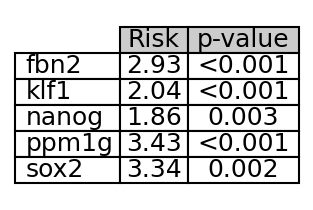

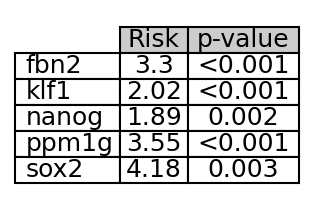

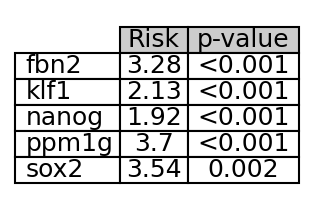

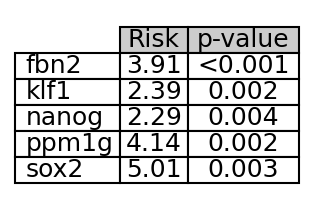

In [34]:
def to_df(all_enrichments):
    rows = []
    for region, features in all_enrichments.items():
        for feature_name, metrics in features.items():
            row = {'Region': region, 'Feature': feature_name}
            row.update(metrics)
            rows.append(row)

    # Create the DataFrame
    df = pd.DataFrame(rows)
    return df.set_index(['Feature', 'Region']).sort_index()

def plot_df(df, title=''):
    df['Risk'] = df['Risk'].round(2)
    df['p-value'] = df['Risk p-value'].apply(lambda x: '<0.001' if x < 0.001 else round(x, 3))
    df = df[['Risk', 'p-value']]

    for feature in ['accessible', 'promoters']:
        _df = df.loc[feature]
        fig, ax = plt.subplots(figsize=(2, 1.5))
        ax.axis('off')
        tbl = ax.table(cellText=_df.values,
                    colLabels=_df.columns,
                    rowLabels=_df.index,
                    cellLoc='center',
                    loc='center',
                    colColours=['#cccccc']*len(_df.columns))

        tbl.auto_set_font_size(False)
        tbl.set_fontsize(12)
        tbl.auto_set_column_width([0,1,2,3,4])

        plt.tight_layout()
        plt.savefig(f'img/regulatory_elements_{title}{feature}.pdf')
        plt.show()

df = to_df(all_enrichments)
reversed_df = to_df(reversed_all_enrichments)

plot_df(df)
plot_df(reversed_df, title='reversed_')

In [33]:
df

Risk  Risk p-value     Prob.  Prob. p-value
Feature      Region                                                 
accessible   fbn2    2.928176      0.000999  0.184448       0.000999
             klf1    2.036421      0.000999  0.256573       0.000999
             nanog   1.863653      0.002997  0.274766       0.002997
             ppm1g   3.431014      0.000999  0.182058       0.000999
             sox2    3.336444      0.001998  0.157267       0.001998
ctcfs        fbn2    1.994283      0.001998  0.128295       0.001998
             klf1    0.691844      0.988012  0.096779       0.988012
             nanog   1.003339      0.475524  0.165625       0.475524
             ppm1g   1.733879      0.027972  0.098125       0.027972
             sox2    1.314953      0.076923  0.065868       0.076923
enhancers    fbn2    2.204552      0.006993  0.141652       0.006993
             klf1    1.210527      0.004995  0.166941       0.004995
             nanog   1.299209      0.001998  0.210601       0.001998
             ppm1g   1.884958      0.009990  0.105527       0.009990
             sox2    1.968896      0.002997  0.096314       0.002997
inaccessible fbn2    0.448732      1.000000  0.062520       1.000000
             klf1    0.502661      1.000000  0.120132       1.000000
             nanog   0.555063      1.000000  0.140650       1.000000
             ppm1g   0.344313      1.000000  0.051316       1.000000
             sox2    0.350307      1.000000  0.045742       1.000000
promoters    fbn2    3.297245      0.000999  0.212292       0.000999
             klf1    2.017584      0.000999  0.279567       0.000999
             nanog   1.893307      0.001998  0.311484       0.001998
             ppm1g   3.553852      0.000999  0.199300       0.000999
             sox2    4.177102      0.002997  0.209063       0.002997

In [ ]:
reversed_df


Risk  Risk p-value     Prob.  Prob. p-value p-value
Feature      Region                                                     
accessible   fbn2    3.28      0.000999  0.034958       0.000999  <0.001
             klf1    2.13      0.000999  0.192318       0.000999  <0.001
             nanog   1.92      0.000999  0.230646       0.000999  <0.001
             ppm1g   3.70      0.000999  0.091197       0.000999  <0.001
             sox2    3.54      0.001998  0.085160       0.001998   0.002
ctcfs        fbn2    2.14      0.000999  0.004458       0.000999  <0.001
             klf1    0.66      0.986014  0.003593       0.986014   0.986
             nanog   1.00      0.482517  0.008600       0.482517   0.483
             ppm1g   1.81      0.025974  0.005635       0.025974   0.026
             sox2    1.34      0.084915  0.002816       0.084915   0.085
enhancers    fbn2    2.39      0.001998  0.006264       0.001998   0.002
             klf1    1.23      0.003996  0.072220       0.003996   0.004
             nanog   1.35      0.000999  0.078368       0.000999  <0.001
             ppm1g   1.96      0.012987  0.027946       0.012987   0.013
             sox2    2.02      0.001998  0.048952       0.001998   0.002
inaccessible fbn2    0.97      1.000000  0.944987       1.000000     1.0
             klf1    0.84      1.000000  0.718834       1.000000     1.0
             nanog   0.83      1.000000  0.667417       1.000000     1.0
             ppm1g   0.90      1.000000  0.854492       1.000000     1.0
             sox2    0.91      1.000000  0.865407       1.000000     1.0
promoters    fbn2    3.91      0.000999  0.002012       0.000999  <0.001
             klf1    2.39      0.001998  0.015567       0.001998   0.002
             nanog   2.29      0.003996  0.007188       0.003996   0.004
             ppm1g   4.14      0.001998  0.015897       0.001998   0.002
             sox2    5.01      0.002997  0.001986       0.002997   0.003

In [18]:
df

Risk  Risk p-value     Prob.  Prob. p-value p-value
Feature      Region                                                     
accessible   fbn2    2.93      0.000999  0.184448       0.000999  <0.001
             klf1    2.04      0.000999  0.256573       0.000999  <0.001
             nanog   1.86      0.002997  0.274766       0.002997   0.003
             ppm1g   3.43      0.000999  0.182058       0.000999  <0.001
             sox2    3.34      0.001998  0.157267       0.001998   0.002
ctcfs        fbn2    1.99      0.001998  0.128295       0.001998   0.002
             klf1    0.69      0.988012  0.096779       0.988012   0.988
             nanog   1.00      0.475524  0.165625       0.475524   0.476
             ppm1g   1.73      0.027972  0.098125       0.027972   0.028
             sox2    1.31      0.076923  0.065868       0.076923   0.077
enhancers    fbn2    2.20      0.006993  0.141652       0.006993   0.007
             klf1    1.21      0.004995  0.166941       0.004995   0.005
             nanog   1.30      0.001998  0.210601       0.001998   0.002
             ppm1g   1.88      0.009990  0.105527       0.009990    0.01
             sox2    1.97      0.002997  0.096314       0.002997   0.003
inaccessible fbn2    0.45      1.000000  0.062520       1.000000     1.0
             klf1    0.50      1.000000  0.120132       1.000000     1.0
             nanog   0.56      1.000000  0.140650       1.000000     1.0
             ppm1g   0.34      1.000000  0.051316       1.000000     1.0
             sox2    0.35      1.000000  0.045742       1.000000     1.0
promoters    fbn2    3.30      0.000999  0.212292       0.000999  <0.001
             klf1    2.02      0.000999  0.279567       0.000999  <0.001
             nanog   1.89      0.001998  0.311484       0.001998   0.002
             ppm1g   3.55      0.000999  0.199300       0.000999  <0.001
             sox2    4.18      0.002997  0.209063       0.002997   0.003

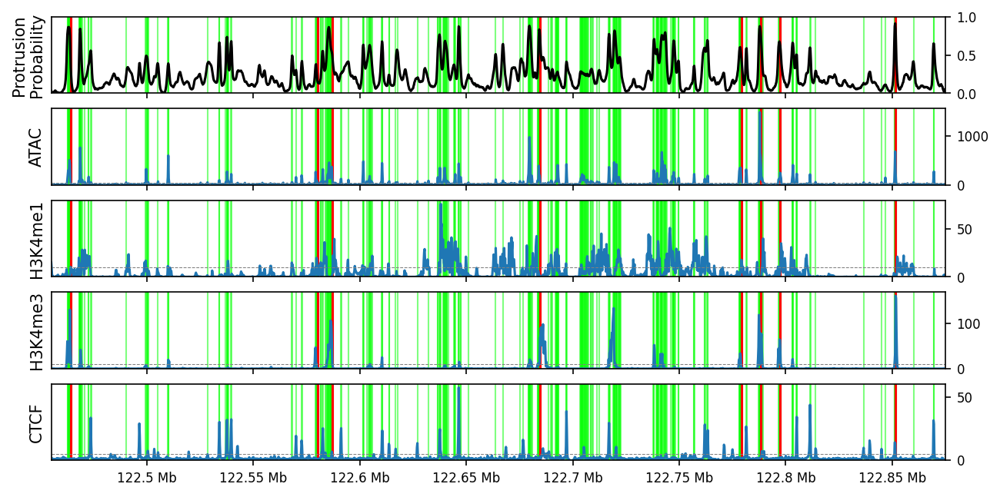

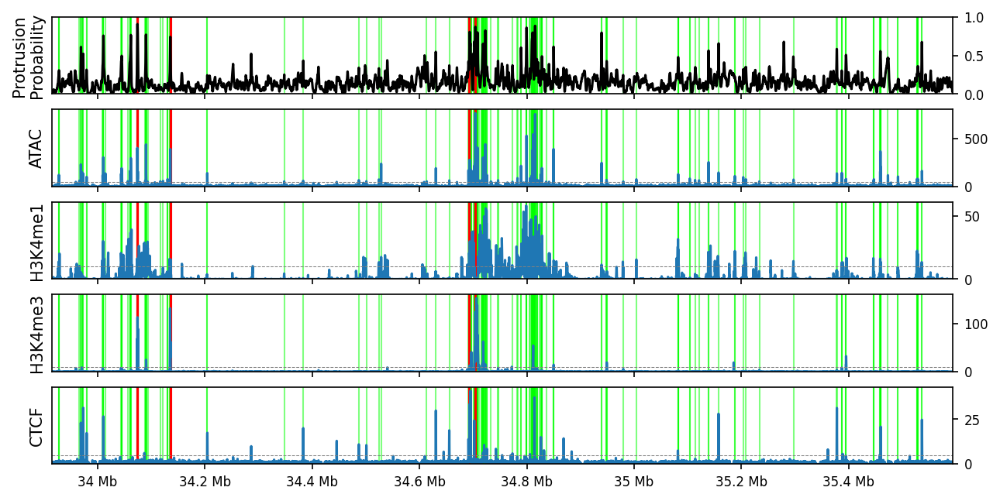

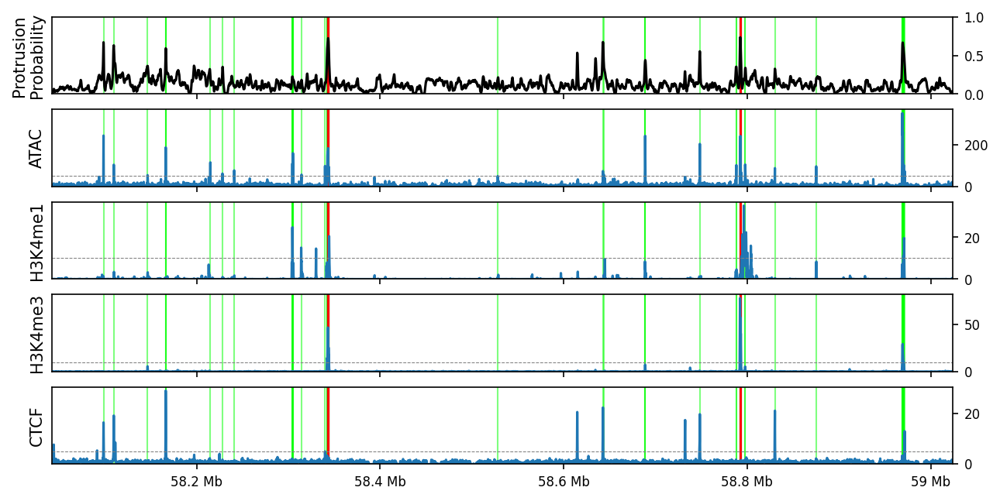

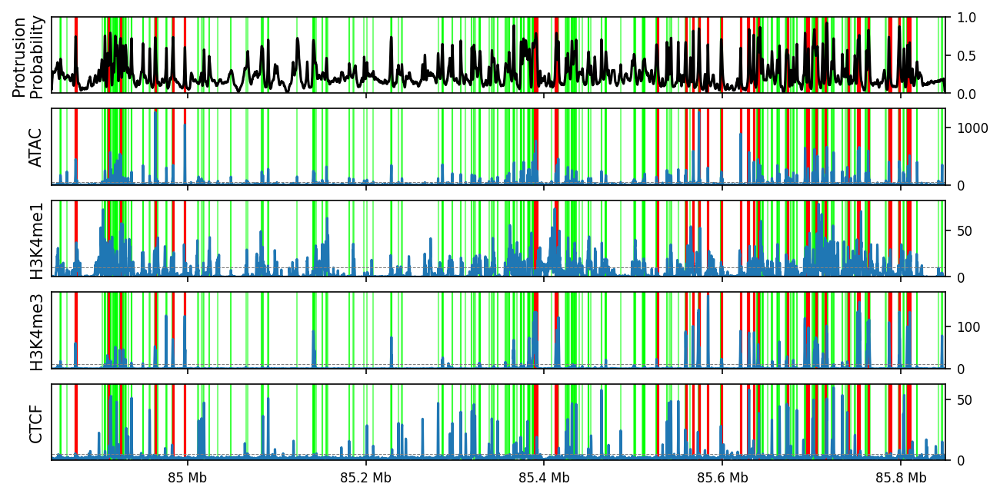

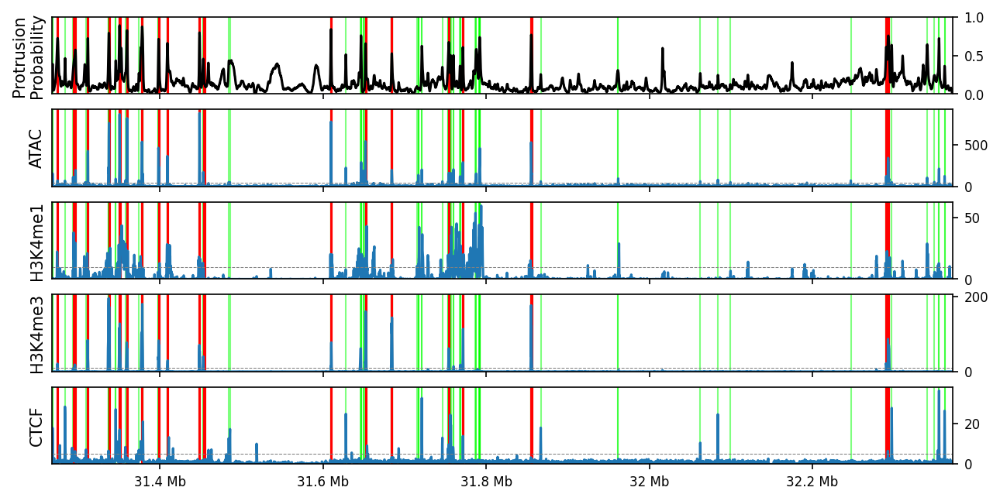

In [23]:
np.random.seed(0)
ins_all_enrichments = {}
ins_reversed_all_enrichments = {}
for name in main_names:
    region = prod[name]['mei'].mei.config['region']
    chrom, start, end = parse_region(region)
    p_loop = np.mean([d.labels == -1 for d in domains_ins[name]], axis=0)
    annotator = RegulatoryElementAnnotator(tracks, thresholds=thresholds)
    elements = annotator.get_regulatory_elements(chrom, start, end)
    ins_all_enrichments[name] = annotator.all_enrichments(elements, domains_ins[name])
    ins_reversed_all_enrichments[name] = annotator.all_enrichments(elements, domains_ins[name], reverse=True)

    f, ax = annotator.plot(elements)
    ax[0].plot(np.arange(start, end, 200), p_loop, color='black')
    ax[0].set_ylim(0, 1)
    ax[0].yaxis.tick_right()
    ax[0].set_ylabel('Protrusion\nProbability')
    ax[0].set_xlim(start, end)
    format_ticks(ax[-1], rotate=False, y=False)
    plt.savefig(f'img/regulatory_elements_ins_{name}.pdf')
    plt.show()

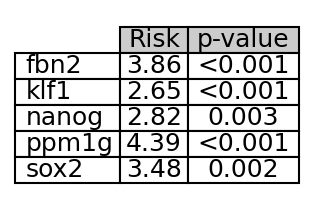

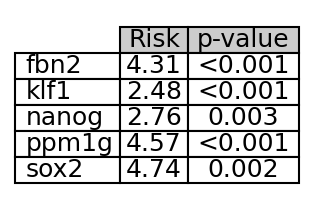

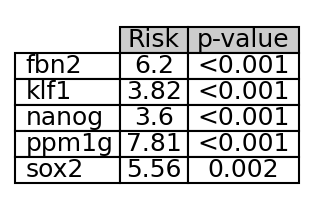

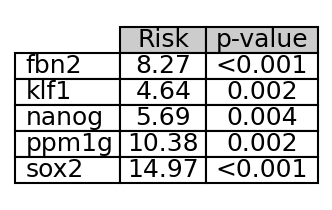

In [24]:
ins_df = to_df(ins_all_enrichments)
ins_reversed_df = to_df(ins_reversed_all_enrichments)

plot_df(ins_df)
plot_df(ins_reversed_df, title='reversed_')

In [25]:
ins_reversed_df

Risk  Risk p-value     Prob.  Prob. p-value p-value
Feature      Region                                                      
accessible   fbn2     6.20      0.000999  0.045625       0.000999  <0.001
             klf1     3.82      0.000999  0.236394       0.000999  <0.001
             nanog    3.60      0.000999  0.312303       0.000999  <0.001
             ppm1g    7.81      0.000999  0.113773       0.000999  <0.001
             sox2     5.56      0.001998  0.088515       0.001998   0.002
ctcfs        fbn2     4.71      0.000999  0.007166       0.000999  <0.001
             klf1     0.92      0.614386  0.004879       0.614386   0.614
             nanog    1.77      0.005994  0.012909       0.005994   0.006
             ppm1g    2.64      0.000999  0.006998       0.000999  <0.001
             sox2     3.17      0.000999  0.005088       0.000999  <0.001
enhancers    fbn2     2.29      0.009990  0.005604       0.009990    0.01
             klf1     1.31      0.000999  0.073505       0.000999  <0.001
             nanog    1.52      0.003996  0.083419       0.003996   0.004
             ppm1g    1.76      0.006993  0.023872       0.006993   0.007
             sox2     1.86      0.000999  0.041897       0.000999  <0.001
inaccessible fbn2     0.95      1.000000  0.928954       1.000000     1.0
             klf1     0.76      1.000000  0.674839       1.000000     1.0
             nanog    0.69      1.000000  0.580390       1.000000     1.0
             ppm1g    0.86      1.000000  0.831532       1.000000     1.0
             sox2     0.90      1.000000  0.863954       1.000000     1.0
promoters    fbn2     8.27      0.000999  0.002626       0.000999  <0.001
             klf1     4.64      0.001998  0.019058       0.001998   0.002
             nanog    5.69      0.003996  0.010445       0.003996   0.004
             ppm1g   10.38      0.001998  0.020340       0.001998   0.002
             sox2    14.97      0.000999  0.002255       0.000999  <0.001

In [26]:
ins_df

Risk  Risk p-value     Prob.  Prob. p-value p-value
Feature      Region                                                     
accessible   fbn2    3.86      0.000999  0.474781       0.000999  <0.001
             klf1    2.65      0.000999  0.554370       0.000999  <0.001
             nanog   2.82      0.002997  0.516967       0.002997   0.003
             ppm1g   4.39      0.000999  0.558897       0.000999  <0.001
             sox2    3.48      0.001998  0.504383       0.001998   0.002
ctcfs        fbn2    3.21      0.000999  0.406761       0.000999  <0.001
             klf1    0.94      0.665335  0.231034       0.665335   0.665
             nanog   1.51      0.005994  0.345451       0.005994   0.006
             ppm1g   2.16      0.000999  0.299861       0.000999  <0.001
             sox2    2.38      0.000999  0.367222       0.000999  <0.001
enhancers    fbn2    1.97      0.014985  0.249911       0.014985   0.015
             klf1    1.23      0.000999  0.298676       0.000999  <0.001
             nanog   1.39      0.004995  0.311497       0.004995   0.005
             ppm1g   1.60      0.003996  0.221822       0.003996   0.004
             sox2    1.67      0.000999  0.254360       0.000999  <0.001
inaccessible fbn2    0.34      1.000000  0.121214       1.000000     1.0
             klf1    0.41      1.000000  0.198247       1.000000     1.0
             nanog   0.38      1.000000  0.169955       1.000000     1.0
             ppm1g   0.29      1.000000  0.122881       1.000000     1.0
             sox2    0.35      1.000000  0.140906       1.000000     1.0
promoters    fbn2    4.31      0.000999  0.546458       0.000999  <0.001
             klf1    2.48      0.000999  0.601651       0.000999  <0.001
             nanog   2.76      0.002997  0.628906       0.002997   0.003
             ppm1g   4.57      0.000999  0.627500       0.000999  <0.001
             sox2    4.74      0.001998  0.732500       0.001998   0.002

# RAD21 depletion figure

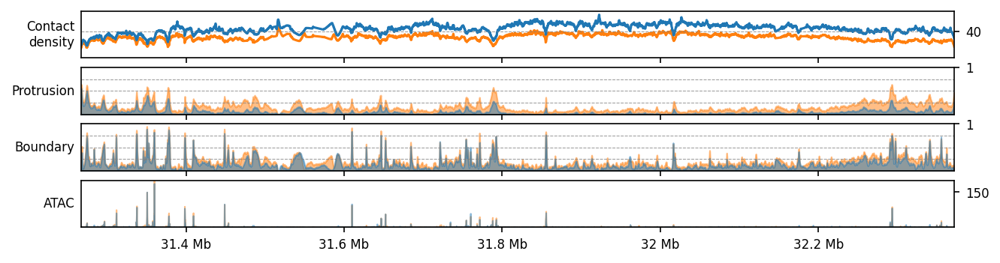

In [37]:
from neighbor_balance.ice import get_marginal

def get_sizes(labels):
    sizes = np.ones(labels.shape)
    for t, label in enumerate(labels):
        for i in np.unique(labels):
            if i < 0:
                continue
            mask = label == i
            sizes[t, mask] = np.sum(mask)
    return sizes

def add_grid(ax):
    for y in [0.25, 0.5, 0.75]:
        ax.axhline(y, c='gray', ls='--', alpha=0.5, lw=0.5)

def plot_all_traces(name, ax, show_sizes=True, color=None):
    region = prod[name]['mei'].mei.config['region']
    chrom, start, end = parse_region(region)
    ref_map = prod[name]['mei'].get_reference_contact_map()
    sim_map = prod[name]['mei'].get_precomputed_contact_map(prod[name]['iteration'])

    packing = np.array([d.labels for d in domains[name]])
    sections = np.array([d.labels for d in domains_ins[name]])

    if 'aid' in name:
        atac = f'{omics}/genomics_data/GSM4984817_Rad21_Halo_AID_6h_auxin.mm39.bw'
    else:
        atac = f'{omics}/genomics_data/GSM4984816_Rad21_Halo_AID_noauxin.mm39.bw'
    atac = load_bw(atac, chrom, start, end)
    atac = bin_track(atac, step=200)
    
    # Contact density
    i = 0
    ax[i].plot(np.arange(start, end, 200), 2*get_marginal(ref_map), c=color)
    ax[i].axhline(40, c='gray', ls='--', alpha=0.5, lw=0.5)
    ax[i].set_ylim(0, 70)
    ax[i].yaxis.tick_right()
    ax[i].set_ylabel('Contact\ndensity', rotation=0, ha='right', va='center', size=8)
    ax[i].set_yticks([40])

    # Packing domain sizes
    if show_sizes:
        i += 1
        sizes = get_sizes(packing[::10])
        low = np.percentile(sizes, 25, axis=0)
        mid = np.percentile(sizes, 50, axis=0)
        high = np.percentile(sizes, 75, axis=0)
        ax[i].axhline(50, c='gray')
        ax[i].fill_between(np.arange(start, end, 200), low, high, facecolor=color, alpha=0.5)
        ax[i].plot(np.arange(start, end, 200), mid, c='magenta')
        ax[i].set_ylim(0, 8500)
        ax[i].set_yticks([5000])
        ax[i].axhline(5000, c='gray', ls='--', alpha=0.5)
        ax[i].set_ylabel('Packing\ndomain size', rotation=0, ha='right', va='center', size=8)

    # Protrusion
    i += 1
    p_loop = np.mean([d.labels == -1 for d in domains[name]], axis=0)
    ax[i].fill_between(np.arange(start, end, 200), 0, p_loop, color=color, alpha=0.5)
    ax[i].set_ylim(0, 1)
    ax[i].yaxis.tick_right()
    ax[i].set_ylabel('Protrusion', rotation=0, ha='right', va='center', size=8)
    ax[i].set_yticks([1])
    add_grid(ax[i])

    # Insulation domain sizes
    if show_sizes:
        i += 1
        sizes = get_sizes(sections[::10])
        low = np.percentile(sizes, 25, axis=0)
        mid = np.percentile(sizes, 50, axis=0)
        high = np.percentile(sizes, 75, axis=0)
        ax[i].axhline(50, c='gray', ls='--', alpha=0.5)
        ax[i].fill_between(np.arange(start, end, 200), low, high, facecolor='blue', alpha=0.25)
        ax[i].plot(np.arange(start, end, 200), mid, c='blue')
        ax[i].set_ylim(0, 160)
        ax[i].set_yticks([50])
        ax[i].set_ylabel('Clutch size', rotation=0, ha='right', va='center', size=8)
    
    # Boundaries
    i += 1
    ax[i].fill_between(np.arange(start, end, 200), 0, np.mean(sections==-1, axis=0), alpha=0.5, color=color)
    ax[i].set_ylim(0, 1)
    ax[i].set_yticks([1])
    ax[i].set_ylabel('Boundary', rotation=0, ha='right', va='center', size=8)
    add_grid(ax[i])

    # ATAC
    i += 1
    ax[i].fill_between(np.arange(start, end, 200), 0, atac, color=color, alpha=0.5)
    ax[i].set_ylim(0, 200)
    ax[i].set_yticks([150])
    ax[i].set_ylabel('ATAC', rotation=0, ha='right', va='center', size=8)

    for a in ax:
        a.yaxis.tick_right()

    ax[-1].set_xlim(start, end)
    format_ticks(ax[-1], y=False, rotate=False)
    return ax

width = 10
height = 2.5
show_sizes = False
f, ax = plt.subplots(6 if show_sizes else 4, figsize=(width, height), sharex=True)

for name, color in [('ppm1g_rad21_aid', 'tab:orange'), ('ppm1g', 'tab:blue')]:
    plot_all_traces(name, ax, color=color, show_sizes=show_sizes)
plt.savefig(f'img/insulation_domains_sizes_ppm1g_rad21.pdf')
plt.show()